In [1]:
import pylcp
import numpy as np
from matplotlib import pyplot as plt
from scipy import constants as const
from sympy.physics.wigner import wigner_3j, wigner_6j, wigner_9j
import sympy
import time
import pathos
from sympy import Symbol
import numbers
from scipy.optimize import bisect
from cmcrameri import cm as scicmap
import tqdm

In [2]:
gamma = 2*np.pi*25e6 # Hz # 10.1103/PhysRevA.108.062821
k = 2*np.pi/261.5e-9 # m^-1 # 10.1103/PhysRevA.108.062821

t_unit = 1/gamma
#t_unit = 1e-1

m_unit = 1/k
#m_unit = 1e-9

velocity_unit = m_unit/t_unit
accel_unit = m_unit/t_unit**2
Hz_unit = 1/t_unit
Js_unit = const.hbar # kg m^2/s
mass_unit = Js_unit*t_unit/m_unit**2
HzperT_unit = const.value("Bohr magneton")/(Js_unit)
T_unit = Hz_unit/HzperT_unit
amu_unit = mass_unit/1.66e-27
cm_unit = m_unit/1e-2
F_unit = mass_unit*m_unit/t_unit**2
I_sat = (np.pi*const.h*const.c*gamma)/(3*227.5e-9**3) # W/m^2

In [3]:
I_sat

2775.1152524702125

In [4]:
print(t_unit)
print(cm_unit)
print(velocity_unit)
print(accel_unit)

6.366197723675814e-09
4.161901761853064e-06
6.5375000000000005
1026908098.6421636


In [5]:
ksim=k*m_unit
gammasim=gamma/Hz_unit
print(ksim)
print(gammasim)

1.0
1.0


In [6]:
mu_q = {}
d_q = {}
H0 = {}

In [7]:
def full_red(J):
    return np.sqrt(2*J+1)

def AState_mu_q(J, lbls, I1, I2): # for the A1Pi state
    Lambda = 1
    def matrix_element(p,F1,F,MF,F1p,Fp,MFp):
        return -float((-1)**(F-MF)*wigner_3j(F,1,Fp,-MF,p,MFp)*\
            np.sqrt(3*(2*F+1)*(2*Fp+1))*wigner_9j(F,Fp,1,F1,F1p,1,I2,I2,0)*full_red(I2)*\
            np.sqrt(3*(2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,1,I1,I1,0)*full_red(I1)*\
            Lambda*(-1)**(J-Lambda)*np.sqrt((2*J+1)*(2*J+1))*wigner_3j(J,1,J,-Lambda,0,Lambda))
    return np.array([[[matrix_element(i,*l1,*l2) for l2 in lbls] for l1 in lbls] for i in [-1,0,1]])

def Q_d_q(J, exlabels, grlabels, I1, I2):
    def matrix_element(p,F1,F,MF,F1p,Fp,MFp):
        return float((-1)**(F-MF)*wigner_3j(F,1,Fp,-MF,p,MFp)*np.sqrt(3*(2*F+1)*(2*Fp+1))*wigner_9j(F,Fp,1,F1,F1p,1,I2,I2,0)*np.sqrt(3*(2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,1,I1,I1,0))*full_red(I2)*full_red(I1)
    raw_dq =  np.array([[[matrix_element(i,*l1,*l2) for l2 in exlabels] for l1 in grlabels] for i in [-1,0,1]])
    norm = np.sqrt(np.sum(np.abs(raw_dq)**2,axis=(0,1)))
    return np.einsum("ijk,k->ijk",raw_dq,1/norm)

In [8]:
test_labels = [[3/2,1,1],[3/2,2,1],[3/2,3,1],[5/2,1,1],[5/2,2,1],[5/2,3,1],[5/2,4,1],[7/2,2,1],[7/2,3,1],[7/2,4,1],[7/2,5,1]]

In [9]:
print(np.diag(AState_mu_q(1,test_labels,5/2,3/2)[1]))

[ 0.1         0.1         0.1        -0.1        -0.05238095 -0.04047619
 -0.03571429 -0.21428571 -0.14285714 -0.11428571 -0.1       ]


In [10]:
def H0_Singlet(J, Lambda, I1, I2, ai = [0,0], eq0Q = [0,0], eq2Q = [0,0], DI = 0): # DOES NOT calculate cross terms between J!!!
    def _delta(i, j, eps = 1e-6):
        return abs(i-j) < eps
    def nuclear_rotation(F1, F, MF, F1p, Fp, MFp):
        I2dotL = (-1)**(2*F1p + F + I2 + 1 + I1 - Lambda)*_delta(MF,MFp)*_delta(F,Fp)\
            *wigner_6j(I2,F1p,F,F1,I2,1)*wigner_6j(J,F1p,I1,F1,J,1)*wigner_3j(J,1,J,-Lambda,0,Lambda)\
            *np.sqrt((2*F1+1)*(2*F1p+1)*(2*J+1)*(2*J+1)*I2*(I2+1)*(2*I2+1))*Lambda
        I1dotL = (-1)**(J+F1+I1+J-Lambda)*_delta(MF,MFp)*_delta(F,Fp)*_delta(F1,F1p)\
            *wigner_6j(I1,J,F1,J,I1,1)\
            *wigner_3j(J,1,J,-Lambda,0,Lambda)*np.sqrt((2*J+1)*(2*J+1)*I1*(I1+1)*(2*I1+1))*Lambda
        return float(ai[0]*I1dotL + ai[1]*I2dotL)
    
    def quadrupole_I1(F1, F, MF, F1p, Fp, MFp):
        return float((-1)**(J+F1+I1+J-Lambda)*_delta(MF,MFp)*_delta(F,Fp)*_delta(F1,F1p)\
            *(wigner_6j(I1,J,F1,J,I1,2)/wigner_3j(I1,2,I1,-I1,0,I1))*np.sqrt((2*J+1)*(2*J+1))\
            *(wigner_3j(J,2,J,-Lambda,0,Lambda)*(eq0Q[0]/4)\
            +np.sum([wigner_3j(J,2,J,-Lambda,q,Lambda)*(eq2Q[0]/(4*np.sqrt(6)))*_delta(Lambda,Lambda+q) for q in [-2,2]])))

    def quadrupole_I2(F1, F, MF, F1p, Fp, MFp):
        return float((-1)**(F+I2+I1-Lambda)*_delta(MF,MFp)*_delta(F,Fp)\
            *wigner_6j(I2,F1p,F,F1,I2,2)*np.sqrt((2*F1p+1)*(2*F1+1))*wigner_6j(F1,J,I1,J,F1p,2)\
            *np.sqrt((2*J+1)*(2*J+1))*wigner_3j(J,2,J,-Lambda, 0, Lambda)*(eq0Q[1]/4)/wigner_3j(I2,2,I2,-I2,0,I2))

    def quadrupole(F1, F, MF, F1p, Fp, MFp):
        return quadrupole_I1(F1, F, MF, F1p, Fp, MFp) + quadrupole_I2(F1, F, MF, F1p, Fp, MFp)

    def nucleon_nucleon(F1, F, MF, F1p, Fp, MFp):
        return float(-DI*np.sqrt(30)*(-1)**(F1p+F+I2)*_delta(MF,MFp)*_delta(F,Fp)*wigner_6j(I2,F1p,F,F1,I2,1)\
            *np.sqrt((2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,2,I1,I1,1)*(-1)**(J-Lambda)\
            *wigner_3j(J,2,J,-Lambda,0,Lambda)*np.sqrt((2*J+1)*(2*J+1)*I1*(I1+1)*(2*I1+1)*I2*(I2+1)*(2*I2+1)))
        
    I12 = int(2*I1)
    I22 = int(2*I2)
    J2 = int(2*J)
    state_labels = np.array([(F12/2,F2/2,MF2/2) for F12 in range(abs(J2-I12),J2+I12+1,2) for F2 in range(abs(F12-I22),F12+I22+1,2) for MF2 in range(-F2,F2+1,2)])
    H0 = np.zeros((state_labels.shape[0],state_labels.shape[0]))
    H0 += np.array([[nuclear_rotation(*labket,*labbra) for labket in state_labels] for labbra in state_labels])
    H0 += np.array([[quadrupole(*labket,*labbra) for labket in state_labels] for labbra in state_labels])
    H0 += np.array([[nucleon_nucleon(*labket,*labbra) for labket in state_labels] for labbra in state_labels])
    return state_labels, H0

In [11]:
labX, H0X = H0_Singlet(1,0,5/2,3/2,eq0Q=[-29.8,-8.6])
# H0X -= np.min(H0X)

In [12]:
labA, H0A = H0_Singlet(1,1,5/2,3/2,ai=[131,42],eq0Q=[-7.6,-51.0])
# H0A -= np.min(H0A)

In [13]:
EX, U = np.linalg.eig(H0X)

In [14]:
EX

array([ 2.4566979 , -4.4446979 ,  4.16817587, -3.47417587, -3.47417587,
        4.16817587,  4.79273926,  0.54582769, -5.30456695,  4.79273926,
        0.54582769, -3.47417587,  0.54582769,  0.54582769,  4.16817587,
       -5.30456695, -5.30456695, -5.30456695, -5.30456695,  4.79273926,
        4.79273926,  4.79273926,  0.54582769,  4.90632585,  4.90632585,
        4.90632585,  4.90632585,  4.90632585, -5.94977752, -5.94977752,
       -5.94977752, -5.94977752, -5.94977752, -5.94977752, -5.94977752,
        4.90632585,  4.90632585,  1.07745167,  1.07745167, -4.4446979 ,
       -4.4446979 , -4.4446979 ,  1.07745167,  1.07745167,  1.07745167,
        1.07745167,  1.07745167, -4.4446979 , -4.4446979 ,  2.4566979 ,
        2.4566979 ,  2.4566979 ,  2.4566979 ,  2.4566979 ,  2.4566979 ,
       -4.4446979 , -4.4446979 , -4.4446979 ,  2.4566979 ,  2.4566979 ,
        3.742     ,  1.06      ,  1.06      ,  1.06      ,  1.06      ,
        1.06      ,  1.06      ,  1.06      ,  1.06      ,  1.06

In [15]:
EA, U = np.linalg.eig(H0A)

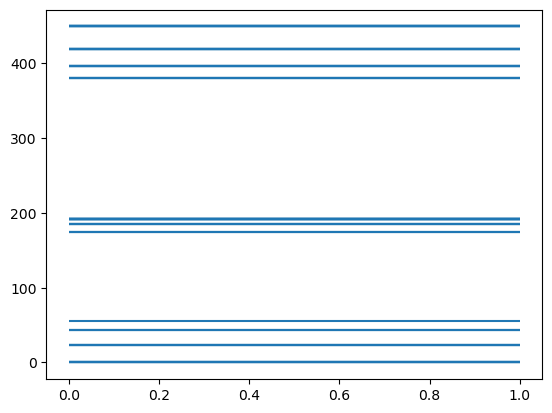

In [16]:
plt.hlines(EA - np.min(EA),xmin=0,xmax=1)

In [17]:
np.sort(EA) - np.min(EA)

array([0.00000000e+00, 1.13686838e-13, 1.70530257e-13, 3.12638804e-13,
       4.26325641e-13, 5.11590770e-13, 6.82121026e-13, 2.27869532e+01,
       2.27869532e+01, 2.27869532e+01, 2.27869532e+01, 2.27869532e+01,
       4.30290253e+01, 4.30290253e+01, 4.30290253e+01, 5.60749799e+01,
       1.75135934e+02, 1.75135934e+02, 1.75135934e+02, 1.85828485e+02,
       1.85828485e+02, 1.85828485e+02, 1.85828485e+02, 1.85828485e+02,
       1.91940373e+02, 1.91940373e+02, 1.91940373e+02, 1.91940373e+02,
       1.91940373e+02, 1.91940373e+02, 1.91940373e+02, 1.91940373e+02,
       1.91940373e+02, 1.92452011e+02, 1.92452011e+02, 1.92452011e+02,
       1.92452011e+02, 1.92452011e+02, 1.92452011e+02, 1.92452011e+02,
       3.80066501e+02, 3.80066501e+02, 3.80066501e+02, 3.80066501e+02,
       3.80066501e+02, 3.96229929e+02, 3.96229929e+02, 3.96229929e+02,
       3.96229929e+02, 3.96229929e+02, 3.96229929e+02, 3.96229929e+02,
       4.19566586e+02, 4.19566586e+02, 4.19566586e+02, 4.19566586e+02,
      

In [18]:
mu_q['X(v=0)'] = np.zeros((3,labX.shape[0],labX.shape[0]))
# mu_q['X(v=1)'] = np.zeros((3,full_labels.shape[0],full_labels.shape[0]))
# mu_q['X(v=2)'] = np.zeros((3,full_labels.shape[0],full_labels.shape[0]))
# H0['X(v=0)'] = (2*np.pi/Hz_unit)*np.diag(np.concatenate([[11.235e6]*8, [0]*12, [7.914e6]*16]))
# H0['X(v=1)'] = (2*np.pi/Hz_unit)*np.diag(np.concatenate([[11.235e6]*8, [0]*12, [7.914e6]*16]))
# H0['X(v=1)'] = np.zeros((full_labels.shape[0],full_labels.shape[0]))
# H0['A(v=0)'] = (2*np.pi/Hz_unit)*np.diag([9.06039e7, 9.06039e7, 9.06039e7, 0., 0., 0., 0., 0., 2.09987e8, 2.09987e8, 2.09987e8, 2.09987e8, 2.09987e8, 1.99498e8, 1.99498e8, 1.99498e8, 1.99498e8, 1.99498e8, 1.99498e8, 1.99498e8, 3.61039e8, 3.61039e8, 3.61039e8, 3.61039e8, 3.61039e8, 3.61039e8, 3.61039e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8, 4.36374e8])
H0['X(v=0)'] = H0X*1e6*2*np.pi/Hz_unit
# H0['X(v=1)'] = H0X*1e6*2*np.pi/Hz_unit
# H0['X(v=2)'] = H0X*1e6*2*np.pi/Hz_unit
H0['A(v=0)'] = H0A*1e6*2*np.pi/Hz_unit
# H0['A(v=1)'] = H0A*1e6*2*np.pi/Hz_unit

In [19]:
def _ishermitian(A):
    """
    Simple method to check if a matrix is Hermitian.
    """
    return np.allclose(A, np.conjugate(A.T), rtol=1e-10, atol=1e-10)

In [20]:
_ishermitian(mu_q['X(v=0)'][2])

True

In [21]:
# def Q_d_q(J, exlabels, grlabels, I1, I2):
#     def matrix_element(p,F1,F,MF,F1p,Fp,MFp):
#         return float((-1)**(F-MF)*wigner_3j(F,1,Fp,-MF,p,MFp)*np.sqrt(3*(2*F+1)*(2*Fp+1))*wigner_9j(F,Fp,1,F1,F1p,1,I2,I2,0)*np.sqrt(3*(2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,1,I1,I1,0))
#     raw_dq =  np.array([[[matrix_element(i,*l1,*l2) for l2 in exlabels] for l1 in grlabels] for i in [-1,0,1]])
#     norm = np.sqrt(np.sum(np.abs(raw_dq)**2,axis=(0,1)))
#     return np.einsum("ijk,k->ijk",raw_dq,1/norm)

In [22]:
dq = Q_d_q(1,labA,labX,5/2,3/2)

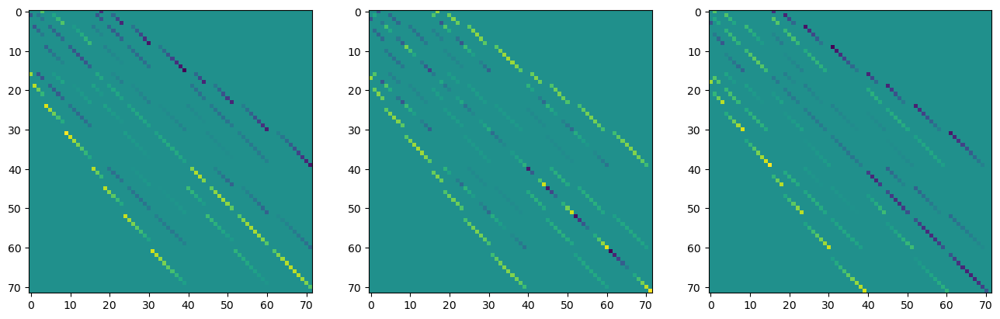

In [23]:
fig, axs1 = plt.subplots(1,3,figsize=[16,12])
[axs1[i].imshow(dq[i]) for i in range(3)]

In [24]:
np.sum(np.abs(dq)**2,axis=(0,1))

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1.])

In [25]:
labA2, H0A2 = H0_Singlet(1,1,5/2,1/2,ai=[131,42],eq0Q=[-7.6,0])

In [26]:
muq = AState_mu_q(1, labA, 5/2, 3/2)

In [27]:
const.physical_constants['Bohr magneton in Hz/T']

(13996244936.1, 'Hz T^-1', 4.2)

In [28]:
Bs = np.linspace(0,1000,100)
Es = np.array([np.linalg.eigh(const.physical_constants['Bohr magneton in Hz/T'][0]*muq[1]*B*1e-6*1e-4 + H0A)[0] for B in Bs])

Text(0, 0.5, '$\\Delta$E [MHz]')

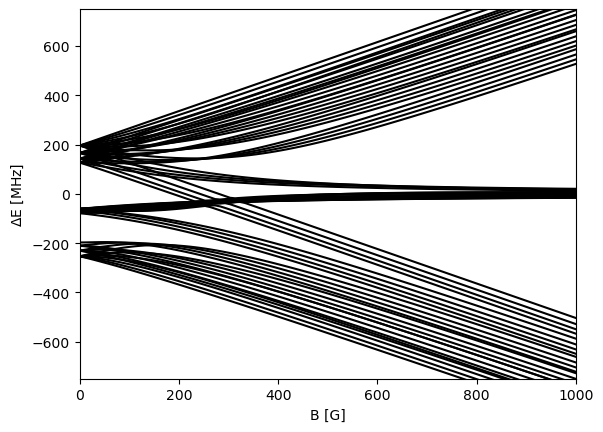

In [29]:
[plt.plot(Bs, Es[:,i],'k') for i in range(Es.shape[1])];
plt.ylim(-750,750)
plt.xlim(0,1000)
plt.xlabel("B [G]")
plt.ylabel("$\\Delta$E [MHz]")

In [30]:
np.diag(muq[1])/labA[:,2]

C:\Users\LP618\AppData\Local\Temp\ipykernel_30332\3808247114.py:1: RuntimeWarning: invalid value encountered in true_divide
  np.diag(muq[1])/labA[:,2]


array([        nan,  0.1       ,         nan,  0.1       ,  0.1       ,
        0.1       ,         nan,  0.1       ,  0.1       ,  0.1       ,
        0.1       ,  0.1       ,         nan,  0.1       ,  0.1       ,
        0.1       , -0.1       ,         nan, -0.1       , -0.05238095,
       -0.05238095,         nan, -0.05238095, -0.05238095, -0.04047619,
       -0.04047619, -0.04047619,         nan, -0.04047619, -0.04047619,
       -0.04047619, -0.03571429, -0.03571429, -0.03571429, -0.03571429,
               nan, -0.03571429, -0.03571429, -0.03571429, -0.03571429,
       -0.21428571, -0.21428571,         nan, -0.21428571, -0.21428571,
       -0.14285714, -0.14285714, -0.14285714,         nan, -0.14285714,
       -0.14285714, -0.14285714, -0.11428571, -0.11428571, -0.11428571,
       -0.11428571,         nan, -0.11428571, -0.11428571, -0.11428571,
       -0.11428571, -0.1       , -0.1       , -0.1       , -0.1       ,
       -0.1       ,         nan, -0.1       , -0.1       , -0.1 

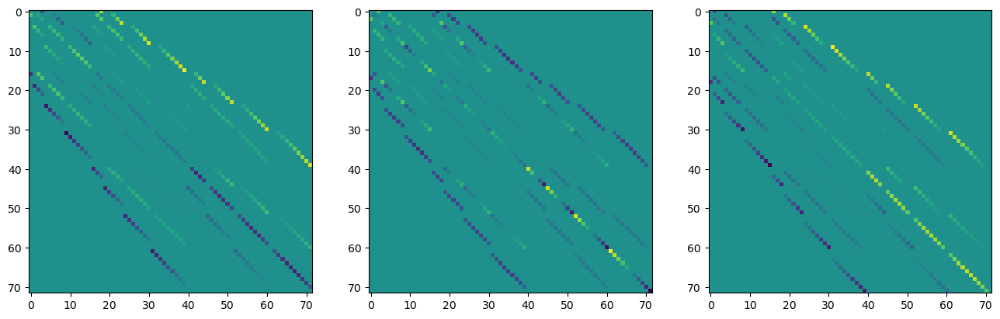

In [31]:
fig, axs1 = plt.subplots(1,3,figsize=[16,12])
[axs1[i].imshow(muq[i]) for i in range(3)]

In [32]:
mu_q['A(v=0)'] = AState_mu_q(1, labA, 5/2,3/2)
# mu_q['A(v=1)'] = AState_mu_q(1, full_labels, 5/2,1/2)
# mu_q['A(v=1)'] = np.zeros((3,36,36))

In [33]:
dijq = dq
d_q[("X(v=0)","A(v=0)")] = dijq#*np.sqrt(0.995)
# d_q[("X(v=1)","A(v=0)")] = dijq*np.sqrt(0.005-1/7800)
# d_q[("X(v=2)","A(v=0)")] = dijq*np.sqrt(1/7800)
# d_q[("X(v=0)","A(v=1)")] = dijq*np.sqrt(0.003621) # From AlF Database 0.003621 0.990524 0.005754
# d_q[("X(v=1)","A(v=1)")] = dijq*np.sqrt(0.990524)
# d_q[("X(v=2)","A(v=1)")] = dijq*np.sqrt(0.005754)

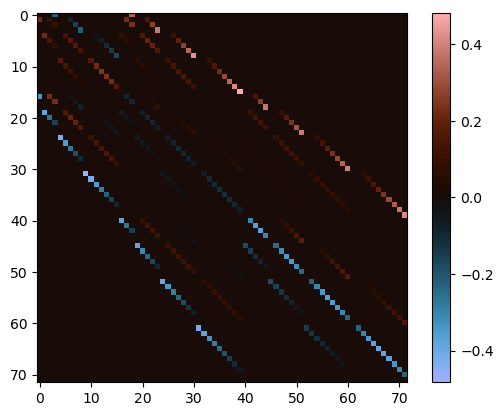

In [34]:
from matplotlib import colors as mcolors
plt.imshow(mu_q["A(v=0)"][0],cmap=scicmap.berlin,norm=mcolors.CenteredNorm())
plt.colorbar()

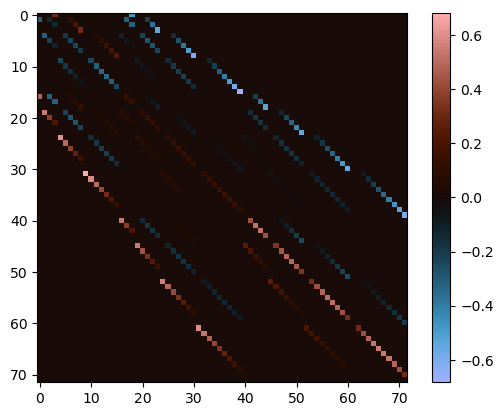

In [35]:
plt.imshow((d_q[("X(v=0)","A(v=0)")][0]),cmap=scicmap.berlin)
plt.colorbar()

In [36]:
eig, U = np.linalg.eigh(H0['A(v=0)']+np.diag([1e-9*i for i in range(72)]))

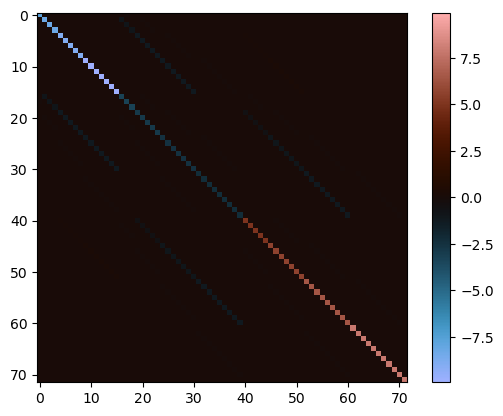

In [37]:
plt.imshow(H0['A(v=0)']+1e-9*mu_q['A(v=0)'][1],cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
plt.colorbar()

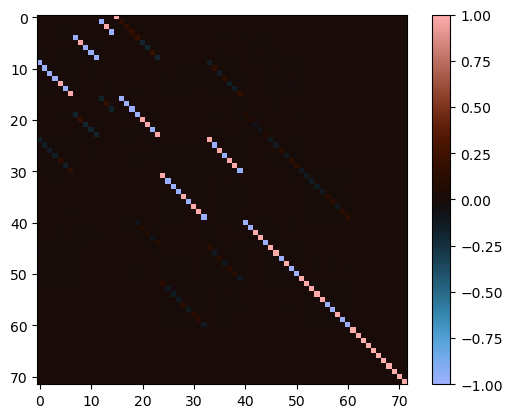

In [38]:
plt.imshow(U,cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
plt.colorbar()

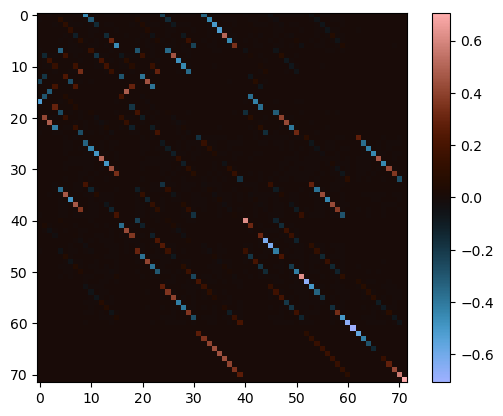

In [39]:
plt.imshow(U.T @ d_q[("X(v=0)","A(v=0)")][1],cmap=scicmap.berlin)
plt.colorbar()

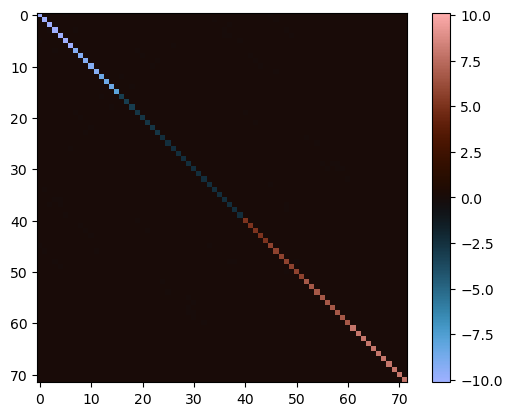

In [40]:
plt.imshow(U.T @ H0['A(v=0)'] @ U,cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
plt.colorbar()

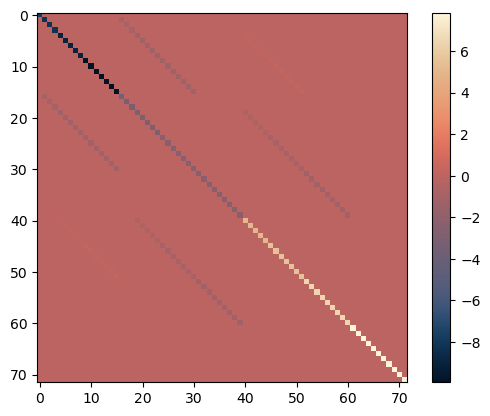

In [41]:
plt.imshow(H0['A(v=0)'],cmap=scicmap.lipari)
plt.colorbar()

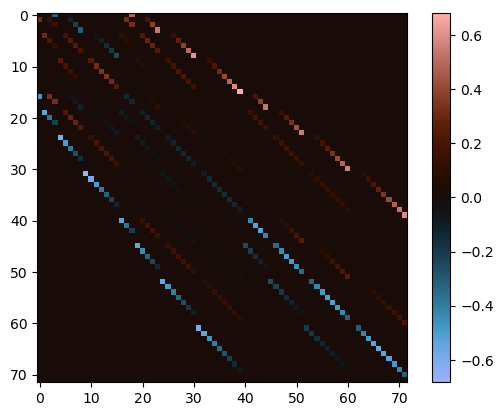

In [42]:
plt.imshow(np.einsum("ijk->ikj",d_q[("X(v=0)","A(v=0)")])[2],cmap=scicmap.berlin,norm=mcolors.CenteredNorm())
plt.colorbar()

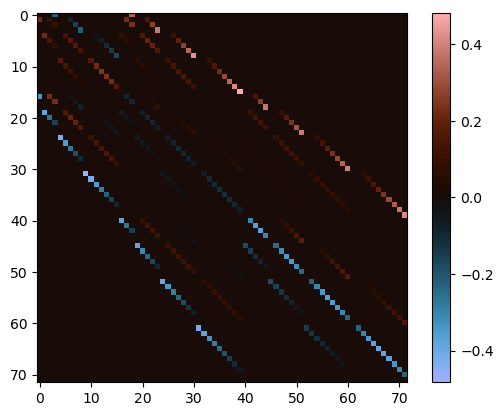

In [43]:
plt.imshow(mu_q["A(v=0)"][0],cmap=scicmap.berlin,norm=mcolors.CenteredNorm())
plt.colorbar()

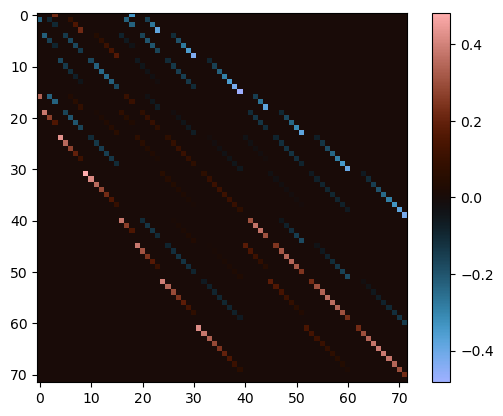

In [44]:
plt.imshow(np.einsum("ijk->ikj",mu_q["A(v=0)"])[2],cmap=scicmap.berlin,norm=mcolors.CenteredNorm())
plt.colorbar()

In [45]:
mu_q.keys()

dict_keys(['X(v=0)', 'A(v=0)'])

In [46]:
hamiltonian = pylcp.hamiltonian(mass=62.45/amu_unit, k=ksim, gamma=gammasim)
[hamiltonian.add_H_0_block(l, H) for l, H in H0.items()]
[hamiltonian.add_mu_q_block(l, mu, muB=1) for l, mu in mu_q.items()]
[hamiltonian.add_d_q_block(l[0],l[1], dq, k=ksim, gamma=gammasim) for l, dq in d_q.items()]
# hamiltonian.add_d_q_block("X(v=0)","A(v=0)",dijq,k=0,gamma=gammasim*0.99)
# hamiltonian.add_d_q_block("A(v=0)","X(v=1)",dijq,k=0,gamma=gammasim*0.01)
hamiltonian.print_structure()
hamiltonian.e = hamiltonian.state_labels == "A(v=0)"

[[((<X(v=0)|H_0|X(v=0)> 72x72), (<X(v=0)|mu_q|X(v=0)> 72x72))
  (<X(v=0)|d_q|A(v=0)> 72x72)]
 [(<A(v=0)|d_q|X(v=0)> 72x72)
  ((<A(v=0)|H_0|A(v=0)> 72x72), (<A(v=0)|mu_q|A(v=0)> 72x72))]]


In [47]:
hamiltonian_no_diag = pylcp.hamiltonian(mass=62.45/amu_unit, k=ksim, gamma=gammasim)
[hamiltonian_no_diag.add_H_0_block(l, H - np.diag(np.diag(H))) for l, H in H0.items()]
[hamiltonian_no_diag.add_mu_q_block(l, mu, muB=1) for l, mu in mu_q.items()]
[hamiltonian_no_diag.add_d_q_block(l[0],l[1], dq, k=ksim, gamma=gammasim) for l, dq in d_q.items()]
# hamiltonian.add_d_q_block("X(v=0)","A(v=0)",dijq,k=0,gamma=gammasim*0.99)
# hamiltonian.add_d_q_block("A(v=0)","X(v=1)",dijq,k=0,gamma=gammasim*0.01)
hamiltonian_no_diag.print_structure()
hamiltonian_no_diag.e = hamiltonian.state_labels == "A(v=0)"

[[((<X(v=0)|H_0|X(v=0)> 72x72), (<X(v=0)|mu_q|X(v=0)> 72x72))
  (<X(v=0)|d_q|A(v=0)> 72x72)]
 [(<A(v=0)|d_q|X(v=0)> 72x72)
  ((<A(v=0)|H_0|A(v=0)> 72x72), (<A(v=0)|mu_q|A(v=0)> 72x72))]]


In [48]:
hamiltonian_no_off_diag = pylcp.hamiltonian(mass=62.45/amu_unit, k=ksim, gamma=gammasim)
[hamiltonian_no_off_diag.add_H_0_block(l, np.zeros(H.shape)) for l, H in H0.items()]
[hamiltonian_no_off_diag.add_mu_q_block(l, mu, muB=1) for l, mu in mu_q.items()]
[hamiltonian_no_off_diag.add_d_q_block(l[0],l[1], dq, k=ksim, gamma=gammasim) for l, dq in d_q.items()]
# hamiltonian.add_d_q_block("X(v=0)","A(v=0)",dijq,k=0,gamma=gammasim*0.99)
# hamiltonian.add_d_q_block("A(v=0)","X(v=1)",dijq,k=0,gamma=gammasim*0.01)
hamiltonian_no_off_diag.print_structure()
hamiltonian_no_off_diag.e = hamiltonian.state_labels == "A(v=0)"

[[((<X(v=0)|H_0|X(v=0)> 72x72), (<X(v=0)|mu_q|X(v=0)> 72x72))
  (<X(v=0)|d_q|A(v=0)> 72x72)]
 [(<A(v=0)|d_q|X(v=0)> 72x72)
  ((<A(v=0)|H_0|A(v=0)> 72x72), (<A(v=0)|mu_q|A(v=0)> 72x72))]]


In [49]:
mag_field = pylcp.fields.quadrupoleMagneticField(500*1e-4*cm_unit*HzperT_unit/Hz_unit)
slowing_field = pylcp.fields.magField(lambda R : np.array([R[0],R[1],-R[2]*2])*250*1e-4*cm_unit*HzperT_unit/Hz_unit if np.abs(R[0]*cm_unit)<1 else np.array([0,0,0]))
no_mag_field = pylcp.fields.constantMagneticField(np.array([0,0,0]))

In [50]:
slowerv = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':-0*80e6*2*np.pi/Hz_unit, 's':10}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
slowerh = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,1,0]), 'pol_coord': 'cartesian', 'delta':-0*80e6*2*np.pi/Hz_unit, 's':10}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
slowerpmod = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,1,0]), 'pol_coord': 'cartesian', 'delta':-5e6*2*np.pi/Hz_unit, 's':5},
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':-5e6*2*np.pi/Hz_unit, 's':5}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
nobeam = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,1,0]), 'pol_coord': 'cartesian', 'delta':0, 's':0}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}

# Null Space

In [51]:
def Q_d_q_sym(J, exlabels, grlabels, I1, I2, q):
    def matrix_element(p,F1,F,MF,F1p,Fp,MFp):
        return sympy.Pow(-1,F-MF)*wigner_3j(F,int(1),Fp,-MF,p,MFp)*sympy.sqrt(3*(2*F+1)*(2*Fp+1))*wigner_9j(F,Fp,1,F1,F1p,1,I2,I2,0)*sympy.sqrt(3*(2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,1,I1,I1,0)
    return sympy.Matrix([[matrix_element(q,*l1,*l2) for l2 in exlabels] for l1 in grlabels])

In [52]:
def matrix_element(p,F1,F,MF,F1p,Fp,MFp,I1,I2,J):
    return sympy.Pow(-1,F-MF)*wigner_3j(F,int(1),Fp,-MF,p,MFp)*sympy.sqrt(3*(2*F+1)*(2*Fp+1))*wigner_9j(F,Fp,1,F1,F1p,1,I2,I2,0)*sympy.sqrt(3*(2*F1+1)*(2*F1p+1))*wigner_9j(F1,F1p,1,J,J,1,I1,I1,0)

In [53]:
symlabels = np.vectorize(lambda x : sympy.Rational(int(2*x),2))(labX)

In [54]:
symlabels[1][2]

-1

In [55]:
d0 = Q_d_q_sym(1,symlabels,symlabels,sympy.Rational(5,2),sympy.Rational(3,2),0)

In [56]:
matrix_element(0,sympy.Rational(7,2),5,4,sympy.Rational(7,2),4,4,sympy.Rational(5,2),sympy.Rational(3,2),J=1)

sqrt(21)/420

In [57]:
matrix_element(0,sympy.Rational(7,2),5,-4,sympy.Rational(7,2),4,-4,sympy.Rational(5,2),sympy.Rational(3,2),J=1)

sqrt(21)/420

In [58]:
wigner_3j(4,1,4,-4,0,4)

2*sqrt(5)/15

In [59]:
cspace = d0.columnspace()
cspace_np = np.vectorize(float)(np.squeeze(np.array(cspace)))

In [60]:
nspace = d0.nullspace()

In [61]:
nspace_np = np.vectorize(float)(np.squeeze(np.array(nspace)))

In [62]:
labels = np.array([tuple(lab) for lab in labX],dtype=np.dtype([("F1",np.float64),("F",np.float64),("mF",np.float64)]))

In [63]:
mfgroup = np.argsort(labels, order=["mF","F1","F"])

In [64]:
labels.shape

(72,)

In [65]:
indx = np.cumsum([np.sum(i == labA[mfgroup][:,-1]) for i in np.unique(labA[mfgroup][:,-1])])

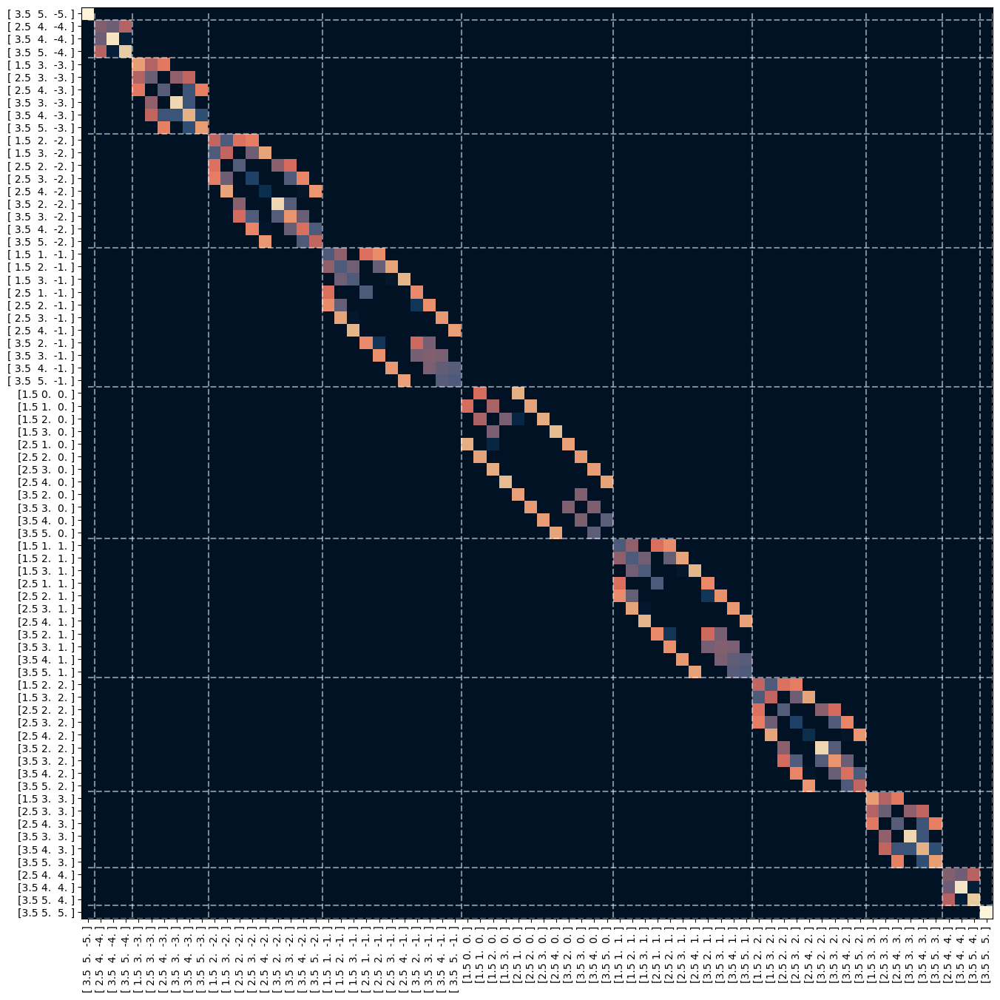

In [66]:
fig, ax = plt.subplots(1,1,figsize=[16,16])
ax.imshow(np.abs(np.squeeze(np.vectorize(float)(d0))[mfgroup][:,mfgroup]), cmap=scicmap.lipari, norm=mcolors.LogNorm(1e-2,clip=True))
ax.hlines(indx-0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
ax.vlines(indx-0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.set_xticks(list(range(72)), rotation='vertical')
ax.set_xticklabels([str(lab) for lab in labX[mfgroup]],  rotation='vertical');

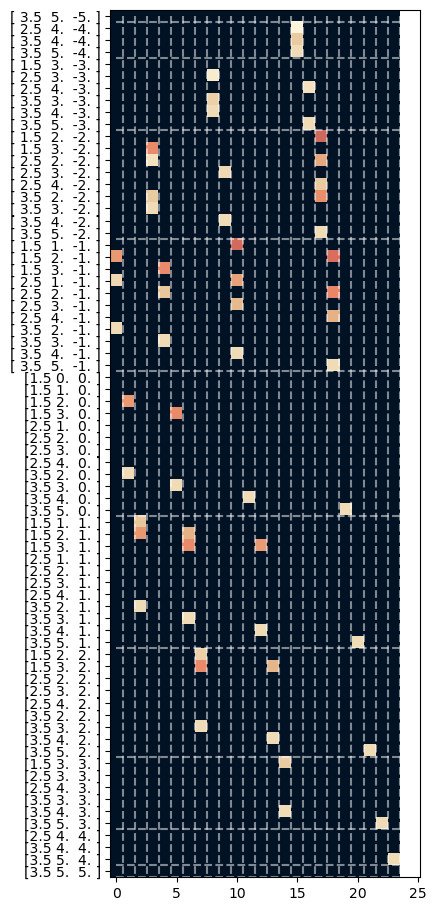

In [67]:
fig, ax = plt.subplots(1,1,figsize=[4,16])
ax.imshow(np.vectorize(float)(np.squeeze(np.array(nspace)[:,mfgroup])).T, cmap=scicmap.lipari, norm = mcolors.LogNorm(1e-4,clip=True))
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.hlines(indx-0.5, 0,24, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.array(list(range(24)))+0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)

In [68]:
norm_nspace = nspace_np/np.sqrt(np.sum(np.abs(nspace_np)**2, axis = 1))[:,np.newaxis]

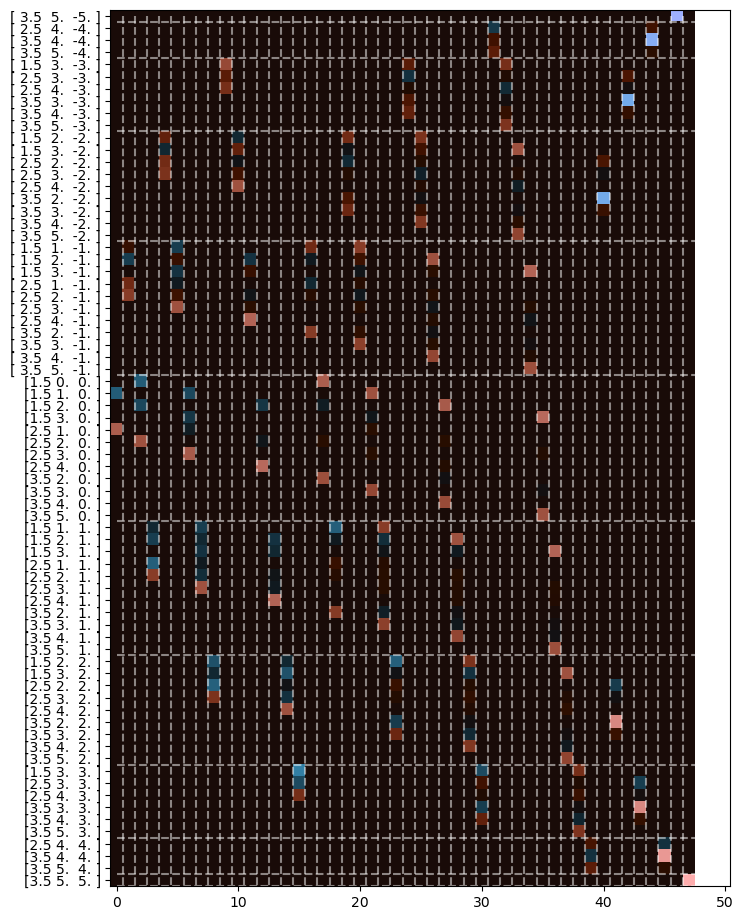

In [69]:
fig, ax = plt.subplots(1,1,figsize=[8,16])
ax.imshow(np.vectorize(float)(np.squeeze(np.array(cspace)[:,mfgroup])).T, cmap=scicmap.berlin, norm = mcolors.CenteredNorm(0))
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.hlines(indx-0.5, 0,48, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.array(list(range(47)))+0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)

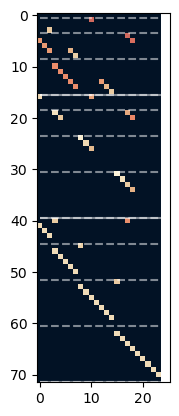

In [70]:
plt.imshow(np.vectorize(float)(np.squeeze(np.array(nspace))).T, cmap=scicmap.lipari, norm = mcolors.LogNorm(1e-4,clip=True))
plt.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, 0,24, colors='w', linestyles='--',alpha=0.5)
plt.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, 0,24, colors='w', linestyles='-',alpha=0.5)

In [71]:
import scipy

In [72]:
orth_nspace = scipy.linalg.orth(nspace_np.T)

In [73]:
qr_nspace = np.linalg.qr(nspace_np.T)
nspace_ord = np.argsort(np.sum(labX[:,-1,np.newaxis]*np.abs(qr_nspace[0])**2,axis=0))
nspace_mF = np.vectorize(lambda x : 0 if np.isclose(x,0) else round(x))(np.sum(labX[:,-1,np.newaxis]*np.abs(qr_nspace[0])**2,axis=0)[nspace_ord])
nspace_index = np.concatenate([np.unique(nspace_mF,return_index=True)[1],[24]])
nspace_ticks = (nspace_index[1:]+nspace_index[:-1])/2
nspace_tickslabels = ["mF="+str(x) for x in np.unique(nspace_mF)]

In [74]:
qr_cspace = np.linalg.qr(cspace_np.T)
cspace_ord = np.argsort(np.sum(labX[:,-1,np.newaxis]*np.abs(qr_cspace[0])**2,axis=0))
cspace_mF = np.vectorize(lambda x : 0 if np.isclose(x,0) else round(x))(np.sum(labX[:,-1,np.newaxis]*np.abs(qr_cspace[0])**2,axis=0)[cspace_ord])
cspace_index = np.concatenate([np.unique(cspace_mF,return_index=True)[1],[24]])
cspace_ticks = (cspace_index[1:]+cspace_index[:-1])/2
cspace_tickslabels = ["mF="+str(x) for x in np.unique(cspace_mF)]

In [75]:
nspace_mF

array([-4, -3, -3, -2, -2, -2, -1, -1, -1, -1,  0,  0,  0,  0,  1,  1,  1,
        1,  2,  2,  2,  3,  3,  4])

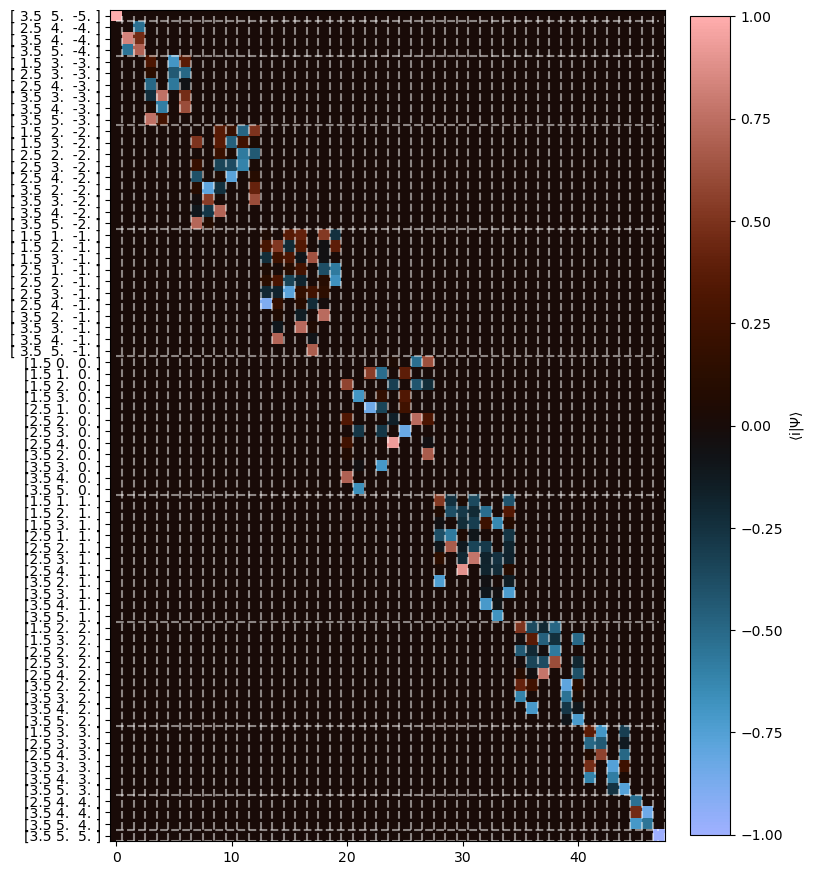

In [76]:
fig, ax = plt.subplots(1,1,figsize=[8,16])
c = ax.imshow(qr_cspace[0][mfgroup][:,cspace_ord], cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.hlines(indx-0.5, 0,47, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.array(list(range(48)))+0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
cax = plt.colorbar(c,fraction=0.066, pad=0.04)
cax.set_label("$\\langle$i|$\\Psi\\rangle$")


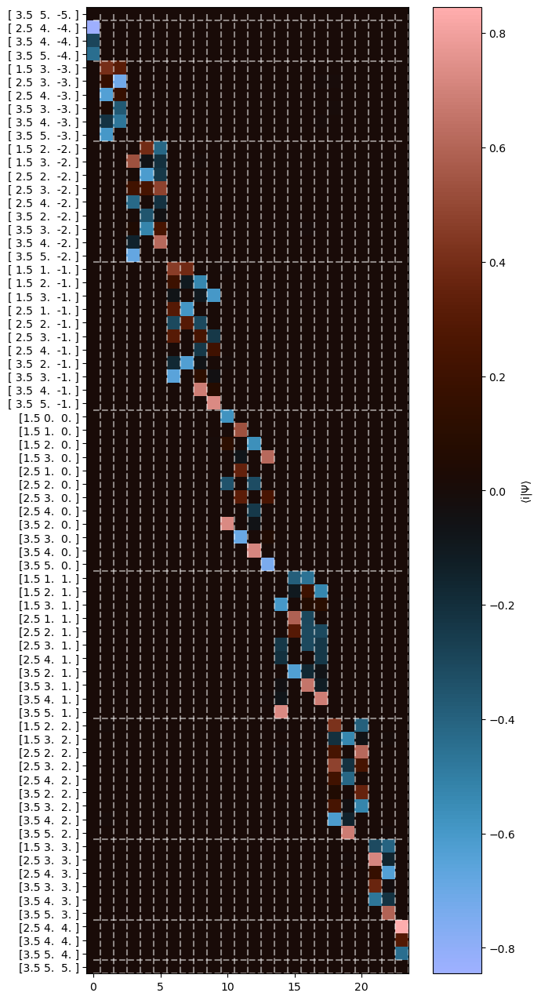

In [77]:
fig, ax = plt.subplots(1,1,figsize=[8,16])
c = ax.imshow(qr_nspace[0][mfgroup][:,nspace_ord], cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.hlines(indx-0.5, 0,23, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.array(list(range(24)))+0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
cax = plt.colorbar(c,ax=ax)
cax.set_label("$\\langle$i|$\\Psi\\rangle$")

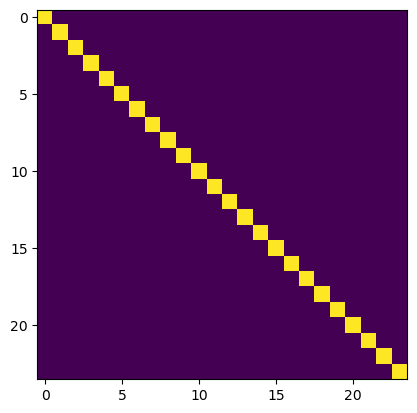

In [78]:
plt.imshow(np.einsum("ij,jk->ik",qr_nspace[0].T,qr_nspace[0]))

In [79]:
scipy_nspace = scipy.linalg.null_space(np.vectorize(float)(d0))

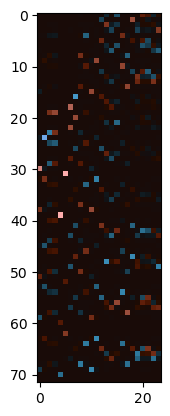

In [80]:
plt.imshow(orth_nspace,cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))

# Slowing

In [81]:
lasers = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':80e6*2*np.pi/Hz_unit, 's':1}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}

In [82]:
from copy import deepcopy

In [83]:
H0p = deepcopy(H0)
# H0p["X(v=0)"] = np.zeros(H0p["X(v=0)"].shape) # np.diag(np.diag(H0p["X(v=0)"]))
# H0p["X(v=0)"] = (H0p["X(v=0)"] - np.diag(np.diag(H0p["X(v=0)"])))
# H0p["X(v=0)"] = np.diag(np.diag(H0p["X(v=0)"]))
# H0p["A(v=0)"] = np.zeros(H0p["A(v=0)"].shape)

In [84]:
ham = pylcp.hamiltonian(mass=62.45/amu_unit, k=ksim, gamma=gammasim)
[ham.add_H_0_block(l, H) for l, H in H0p.items()]
[ham.add_mu_q_block(l, mu, muB=1) for l, mu in mu_q.items()]
[ham.add_d_q_block(l[0],l[1], dq, k=ksim, gamma=gammasim) for l, dq in d_q.items()]
# hamiltonian.add_d_q_block("X(v=0)","A(v=0)",dijq,k=0,gamma=gammasim*0.99)
# hamiltonian.add_d_q_block("A(v=0)","X(v=1)",dijq,k=0,gamma=gammasim*0.01)
ham.print_structure()

[[((<X(v=0)|H_0|X(v=0)> 72x72), (<X(v=0)|mu_q|X(v=0)> 72x72))
  (<X(v=0)|d_q|A(v=0)> 72x72)]
 [(<A(v=0)|d_q|X(v=0)> 72x72)
  ((<A(v=0)|H_0|A(v=0)> 72x72), (<A(v=0)|mu_q|A(v=0)> 72x72))]]


In [85]:
lasers = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':80e6*2*np.pi/Hz_unit, 's':1}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
mcwf = pylcp.MCWF(lasers, no_mag_field, ham)
mcwf.set_initial_psi(np.concatenate([[0]*72,[1/72]*72]))
# mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,7],[0]*72]))

In [86]:
def run(mcwf, i):
    Psi0 = np.zeros(mcwf.hamiltonian.n)
    Psi0[H0A.shape[0]:] = 1/H0A.shape[0]
    mcwf.set_initial_psi(Psi0)

In [87]:
class FakeRandClass:
    def __init__(self):
        pass
    def random(self, x):
        return [1]*int(x)

fake_rand = FakeRandClass()

In [88]:

def multiple_formatter(denominator=2, number=np.pi, latex='\pi'):
    def gcd(a, b):
        while b:
            a, b = b, a%b
        return a
    def _multiple_formatter(x, pos):
        den = denominator
        num = np.int(np.rint(den*x/number))
        com = gcd(num,den)
        (num,den) = (int(num/com),int(den/com))
        if den==1:
            if num==0:
                return r'$0$'
            if num==1:
                return r'$%s$'%latex
            elif num==-1:
                return r'$-%s$'%latex
            else:
                return r'$%s%s$'%(num,latex)
        else:
            if num==1:
                return r'$\frac{%s}{%s}$'%(latex,den)
            elif num==-1:
                return r'$\frac{-%s}{%s}$'%(latex,den)
            else:
                return r'$\frac{%s%s}{%s}$'%(num,latex,den)
    return _multiple_formatter

In [89]:
rtime = 10e-6
ts =np.linspace(0,rtime/t_unit,5000)
runN = 1

# mcwf.set_initial_psi(initpsi2)
# sols = [mcwf.evolve_state([ts[0],ts[-1]],
#                 t_eval=ts,
#                 save_decay=True,
#                 progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
#                 # rng = fake_rand,
#                 rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23") for i in tqdm.tqdm(range(runN))]

sols = []
for i in tqdm.tqdm(range(qr_nspace[0].shape[1])):
    mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,i],[0]*72]))
    sols.append(mcwf.evolve_state([ts[0],ts[-1]],
                t_eval=ts,
                save_decay=True,
                progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
                # rng = fake_rand,
                rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23"))

  0%|          | 0/24 [00:00<?, ?it/s]c:\Users\LP618\Anaconda3\lib\site-packages\scipy\integrate\_ivp\common.py:39: UserWarning: The following arguments have no effect for a chosen solver: `freeze_axis`.
  warn("The following arguments have no effect for a chosen solver: {}."


  4%|▍         | 1/24 [00:16<06:29, 16.93s/it]

Completed in 16.86 s.                                               


c:\Users\LP618\Anaconda3\lib\site-packages\scipy\integrate\_ivp\common.py:39: UserWarning: The following arguments have no effect for a chosen solver: `freeze_axis`.
  warn("The following arguments have no effect for a chosen solver: {}."


Completed in 14.74 s.                                               


  8%|▊         | 2/24 [00:31<05:45, 15.69s/it]

 12%|█▎        | 3/24 [00:47<05:28, 15.67s/it]

Completed in 15.58 s.                                               


 17%|█▋        | 4/24 [01:02<05:11, 15.58s/it]

Completed in 15.38 s.                                               


 21%|██        | 5/24 [01:17<04:52, 15.41s/it]

Completed in 15.06 s.                                               
Completed in 15.73 s.                                               


 25%|██▌       | 6/24 [01:33<04:39, 15.54s/it]

 29%|██▉       | 7/24 [01:48<04:20, 15.35s/it]

Completed in 14.88 s.                                               


 33%|███▎      | 8/24 [02:03<04:01, 15.11s/it]

Completed in 14.54 s.                                               


 38%|███▊      | 9/24 [02:18<03:46, 15.10s/it]

Completed in 14.98 s.                                               
Completed in 17.25 s.                                               


 42%|████▏     | 10/24 [02:35<03:41, 15.79s/it]

 46%|████▌     | 11/24 [02:52<03:30, 16.20s/it]

Completed in 17.07 s.                                               


 50%|█████     | 12/24 [03:29<04:29, 22.46s/it]

Completed in 36.68 s.                                               


 54%|█████▍    | 13/24 [03:58<04:27, 24.36s/it]

Completed in 28.67 s.                                               


 58%|█████▊    | 14/24 [04:22<04:01, 24.20s/it]

Completed in 23.75 s.                                               


 62%|██████▎   | 15/24 [04:42<03:28, 23.12s/it]

Completed in 20.53 s.                                               


 67%|██████▋   | 16/24 [05:01<02:54, 21.87s/it]

Completed in 18.89 s.                                               


 71%|███████   | 17/24 [05:20<02:27, 21.02s/it]

Completed in 18.96 s.                                               


 75%|███████▌  | 18/24 [05:37<01:58, 19.80s/it]

Completed in 16.90 s.                                               


 79%|███████▉  | 19/24 [05:55<01:36, 19.23s/it]

Completed in 17.84 s.                                               


 83%|████████▎ | 20/24 [06:10<01:11, 17.95s/it]

Completed in 14.90 s.                                               


 88%|████████▊ | 21/24 [06:26<00:52, 17.42s/it]

Completed in 16.12 s.                                               


 92%|█████████▏| 22/24 [06:44<00:35, 17.57s/it]

Completed in 17.84 s.                                               


 96%|█████████▌| 23/24 [06:59<00:16, 16.81s/it]

Completed in 14.99 s.                                               


100%|██████████| 24/24 [07:14<00:00, 18.12s/it]

Completed in 15.12 s.                                               


  0%|          | 0/24 [00:00<?, ?it/s]C:\Users\LP618\AppData\Local\Temp\ipykernel_11564\2415374665.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  num = np.int(np.rint(den*x/number))
 83%|████████▎ | 20/24 [02:03<00:23,  5.87s/it]C:\Users\LP618\AppData\Local\Temp\ipykernel_11564\399871257.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max

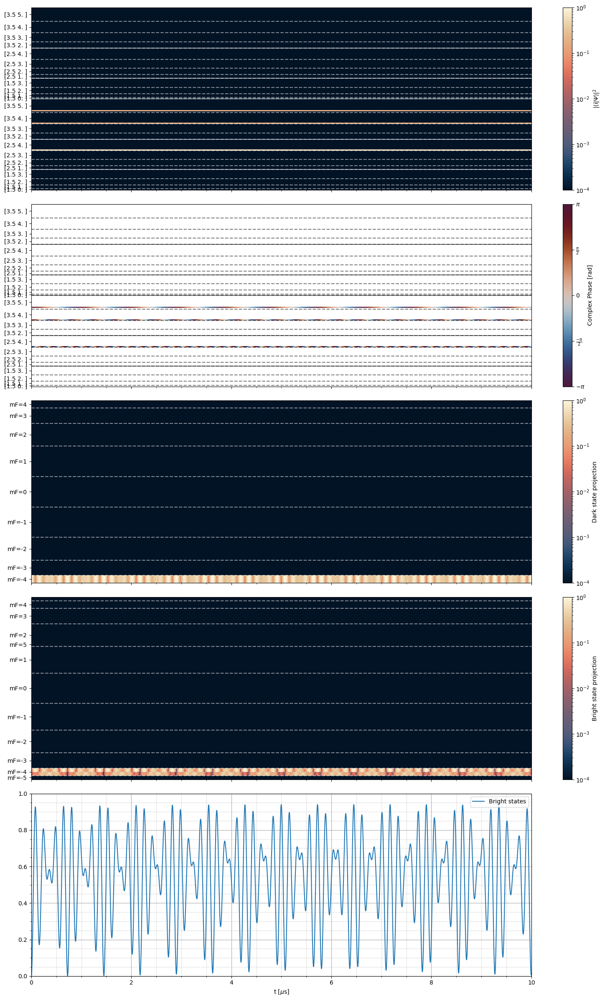

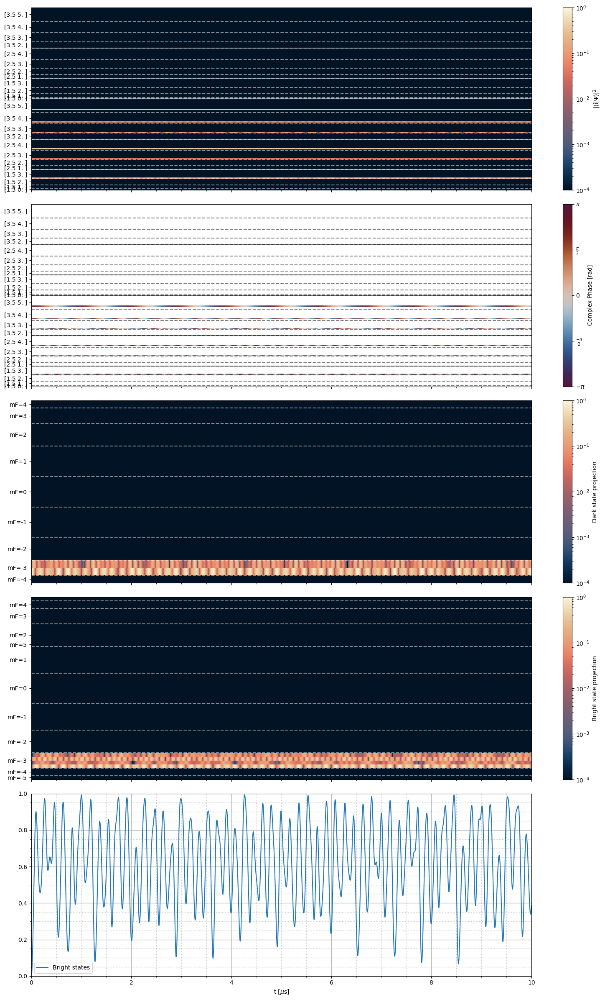

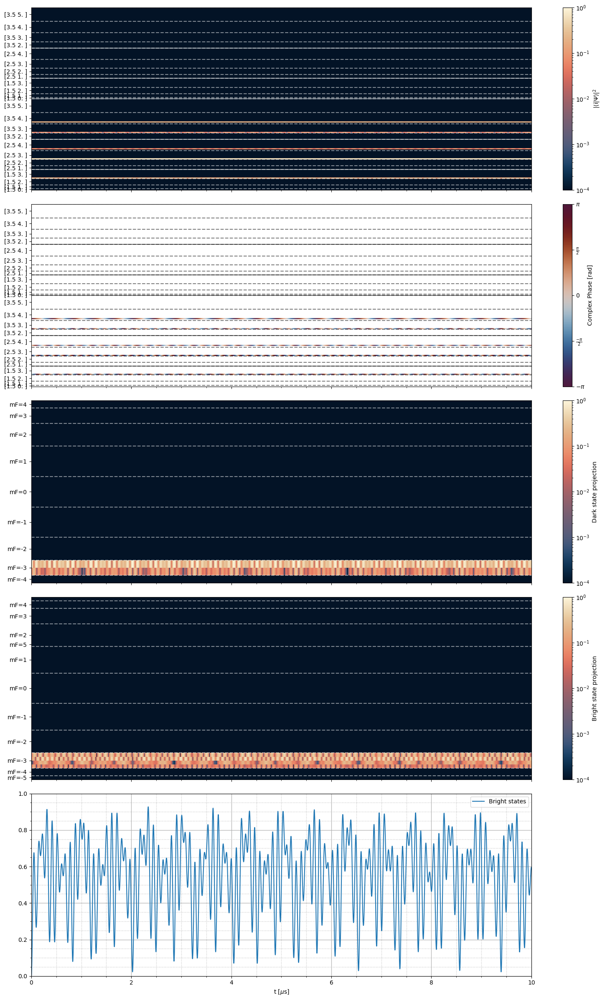

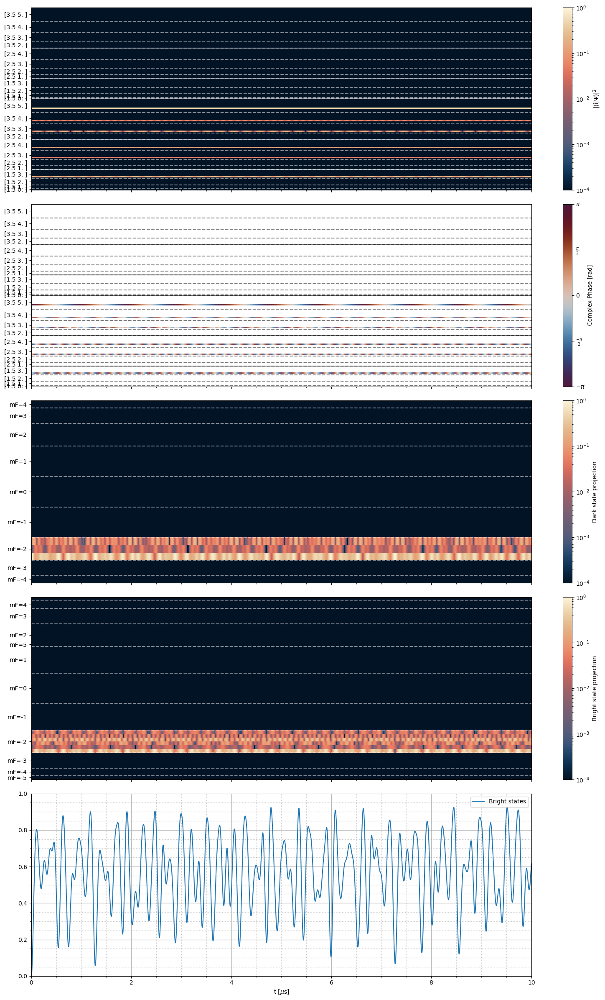

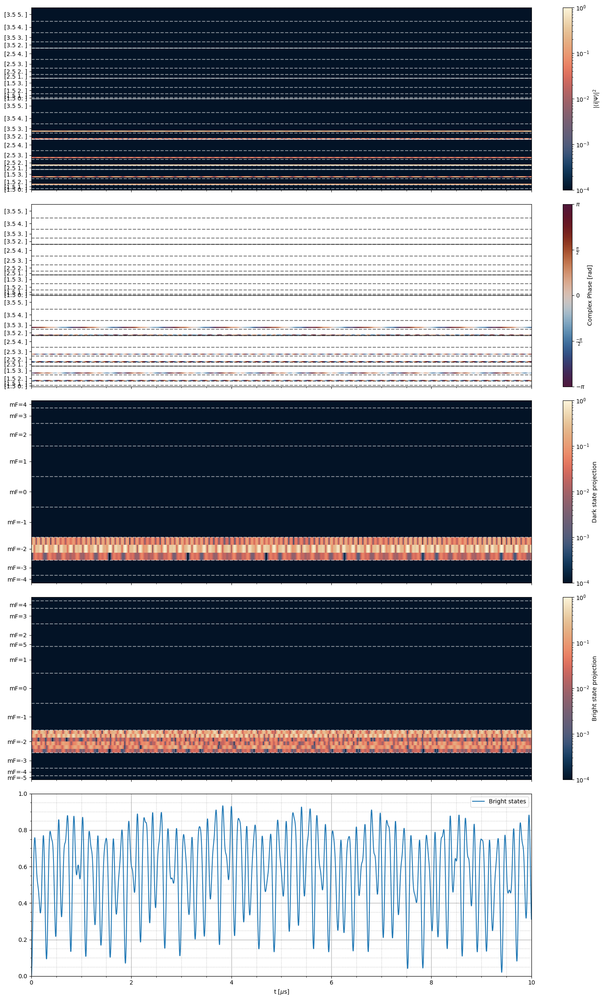

...

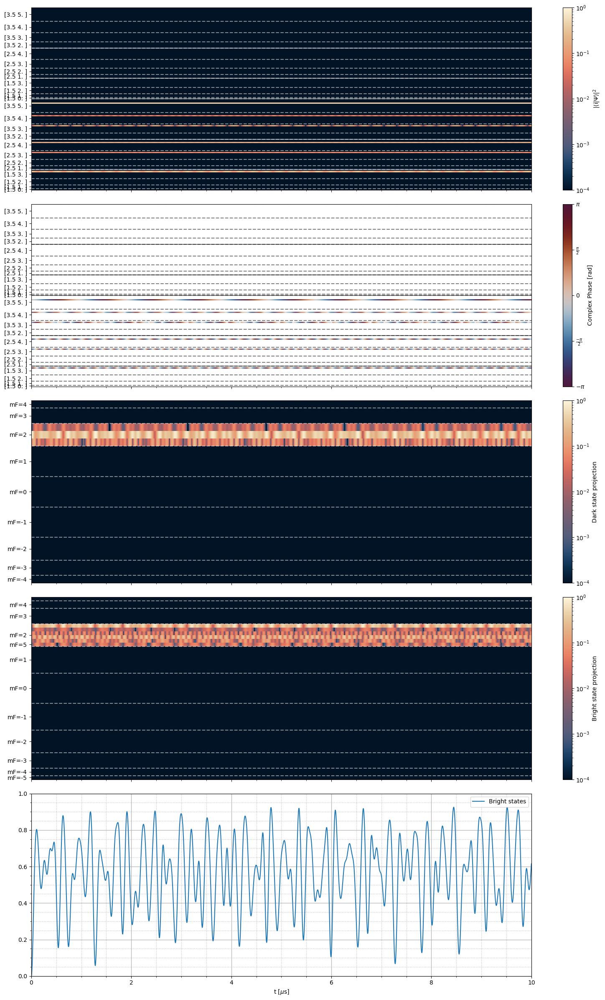

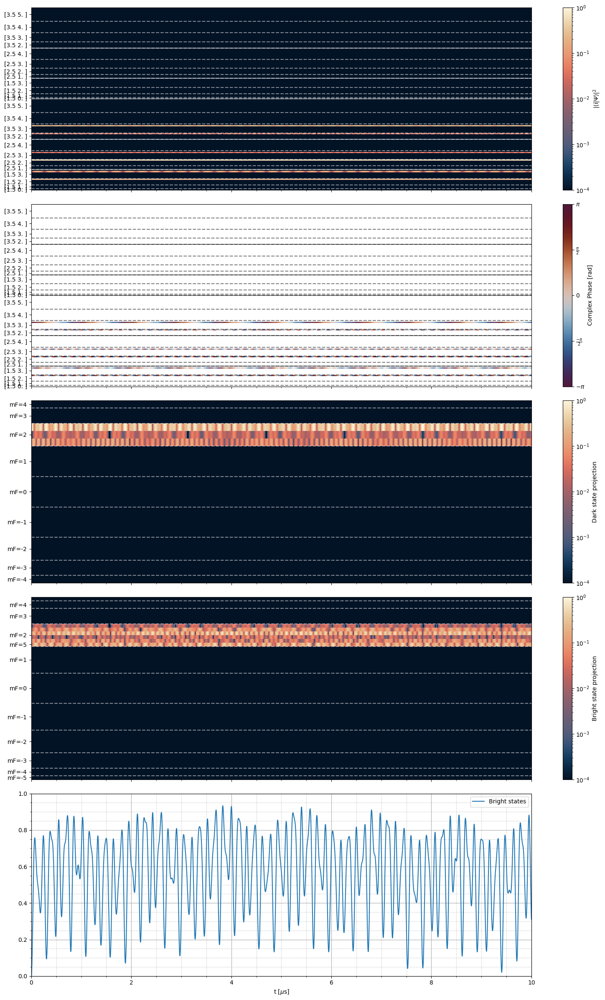

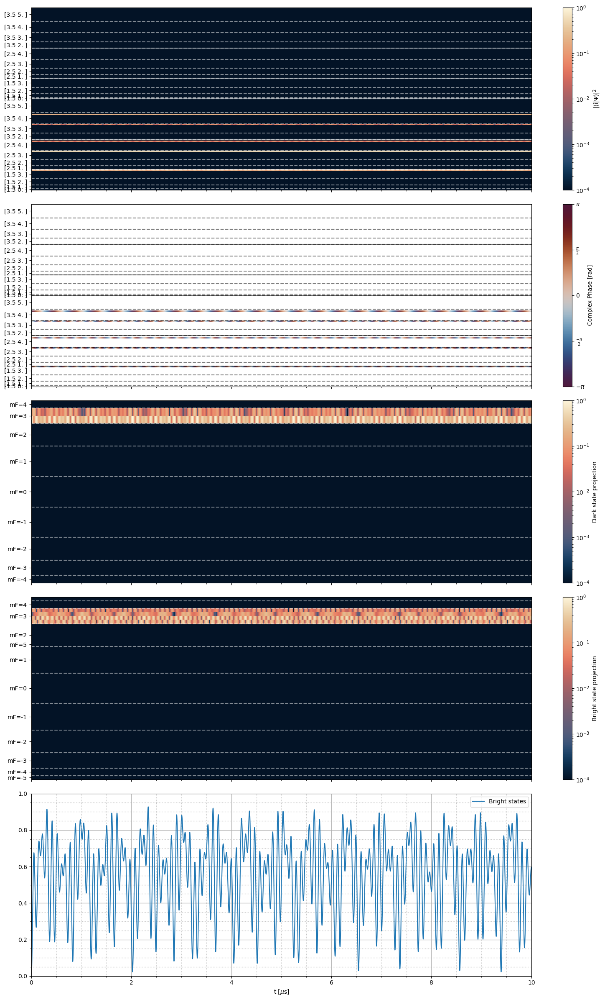

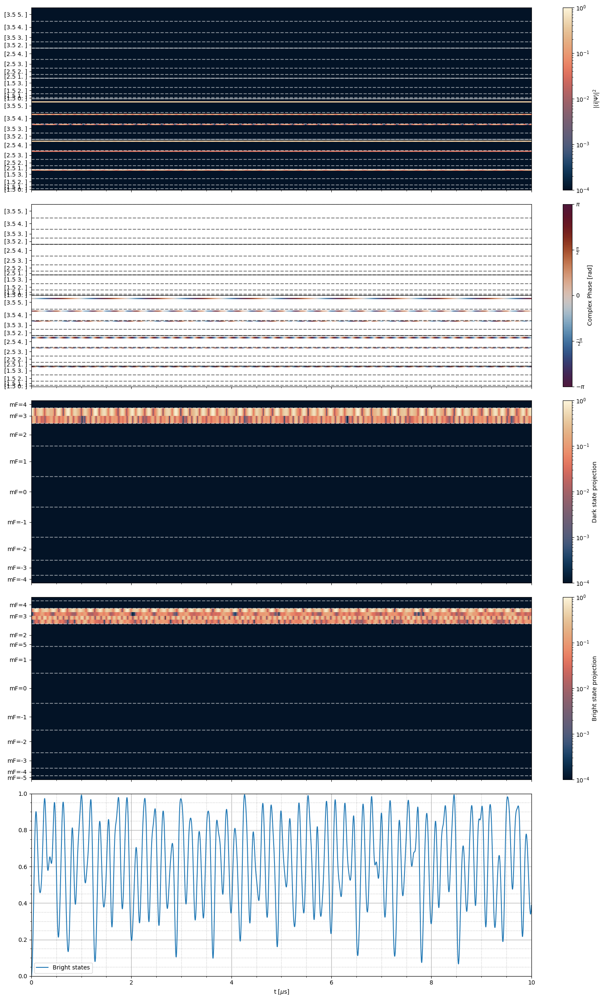

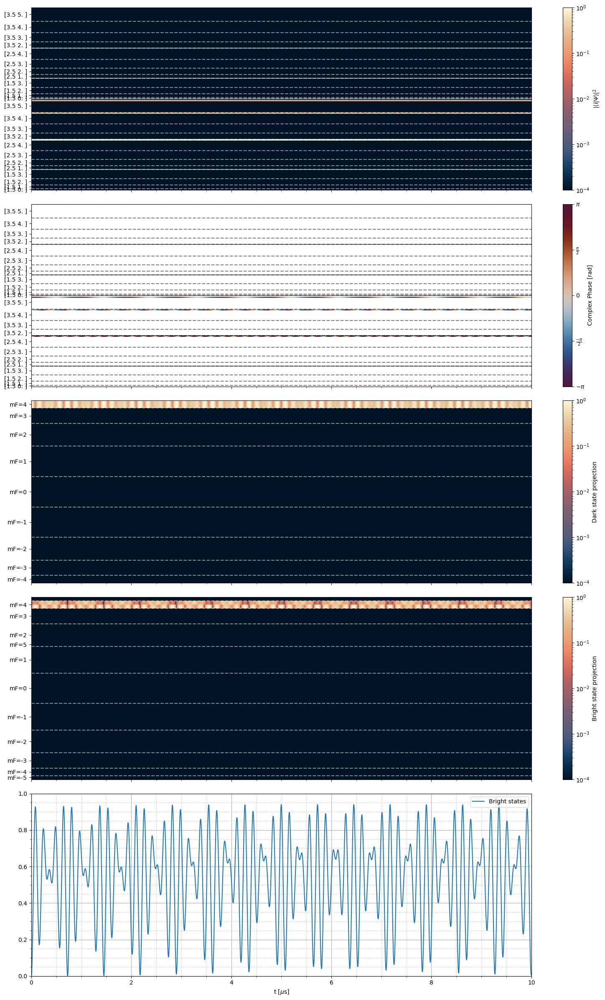

In [90]:
for sol in tqdm.tqdm(sols):
    fig, (ax, axp, axd, axb, ax2) = plt.subplots(5,1,figsize=[16,24],sharex=True)
    coeffs = lambda xs : np.array([np.abs(x.Psi)**2 for x in xs])
    phases = lambda xs : np.array([np.angle(x.Psi) for x in xs])
    cfs = np.sum(coeffs(np.array([sol])),axis=0)
    phs = phases([sol])[0]
    dstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_nspace[0].T)))**2)[nspace_ord]
    shp = dstate_pop.shape
    # dstate_pop = np.append(dstate_pop,1-np.sum(dstate_pop,axis=0)).reshape((shp[0]+1,shp[1]))

    bstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_cspace[0].T)))**2)[cspace_ord]


    ev_times = [ev[-1]*t_unit*1e6 for ev in sol.decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),cfs,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

    c = axp.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),phs,cmap = scicmap.vikO, rasterized=True, norm = mcolors.Normalize(-np.pi,np.pi), alpha=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True)(cfs))#, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axp.get_xlim()
    ylim = axp.get_ylim()
    axp.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axp.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    axp.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    caxp = plt.colorbar(c,ax=axp, ticks = plt.MultipleLocator(np.pi / 2), format = plt.FuncFormatter(multiple_formatter()))
    caxp.set_label("Complex Phase [rad]")

    cd = axd.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(nspace_np.shape[0]))),dstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axd.get_xlim()
    ylim = axd.get_ylim()
    axd.hlines(nspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axd.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axd.set_yticks(nspace_ticks-0.5)
    axd.set_yticklabels(nspace_tickslabels)
    caxd = plt.colorbar(cd,ax=axd)
    caxd.set_label("Dark state projection")

    cb = axb.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(cspace_np.shape[0]))),bstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axb.get_xlim()
    ylim = axb.get_ylim()
    axb.hlines(cspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axb.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axb.set_yticks(cspace_ticks-0.5)
    axb.set_yticklabels(cspace_tickslabels)
    caxb = plt.colorbar(cb,ax=axb)
    caxb.set_label("Bright state projection")

    # ax2.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    # ax2.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    # ax2.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    # ax2.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax2.plot(ts*t_unit*1e6,np.sum(bstate_pop,axis=0),label="Bright states")
    ax2.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax2.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax2.minorticks_on()
    ax2.legend()
    ax2.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax2.get_xlim()
    ylim = ax2.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax2.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    ax2.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    # ax2.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")
    # cax2 = plt.colorbar(cd,ax=ax2)
    # cax2.set_label("Placeholder")
    fig.tight_layout()

    pos = ax.get_position()
    pos2 = ax2.get_position()
    ax2.set_position([pos.x0,pos2.y0,pos.width,pos2.height])

In [91]:
rtime = 1000e-6
ts =np.linspace(0,rtime/t_unit,50000)
runN = 1

# mcwf.set_initial_psi(initpsi2)
sols = [mcwf.evolve_state([ts[0],ts[-1]],
                t_eval=ts,
                save_decay=True,
                progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
                # rng = fake_rand,
                decay_ops='pol',
                rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23") for i in tqdm.tqdm(range(runN))]

# sols = []
# for i in tqdm.tqdm(range(qr_nspace[0].shape[1])):
#     mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,i],[0]*72]))
#     sols.append(mcwf.evolve_state([ts[0],ts[-1]],
#                 t_eval=ts,
#                 save_decay=True,
#                 progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
#                 # rng = fake_rand,
#                 rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23"))

  0%|          | 0/1 [00:00<?, ?it/s]c:\Users\LP618\Anaconda3\lib\site-packages\scipy\integrate\_ivp\common.py:39: UserWarning: The following arguments have no effect for a chosen solver: `freeze_axis`.
  warn("The following arguments have no effect for a chosen solver: {}."


Completed in 23:18.                                                 


100%|██████████| 1/1 [23:19<00:00, 1399.36s/it]


  0%|          | 0/1 [00:00<?, ?it/s]

C:\Users\LP618\AppData\Local\Temp\ipykernel_31720\2415374665.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  num = np.int(np.rint(den*x/number))
100%|██████████| 1/1 [00:53<00:00, 53.16s/it]


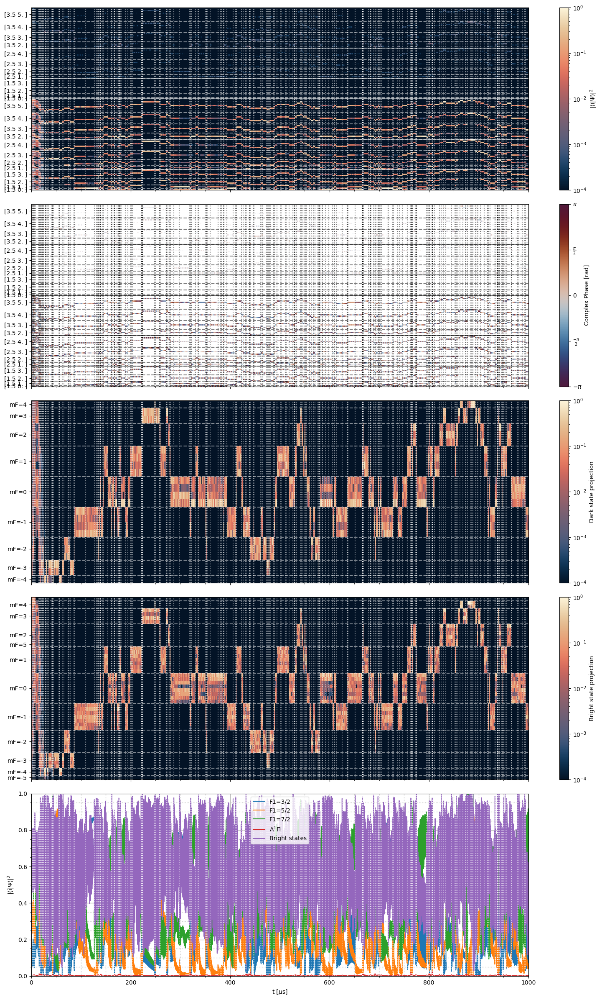

In [ ]:
for sol in tqdm.tqdm(sols):
    fig, (ax, axp, axd, axb, ax2) = plt.subplots(5,1,figsize=[16,24],sharex=True)
    coeffs = lambda xs : np.array([np.abs(x.Psi)**2 for x in xs])
    phases = lambda xs : np.array([np.angle(x.Psi) for x in xs])
    cfs = np.sum(coeffs(np.array([sol])),axis=0)
    phs = phases([sol])[0]
    dstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_nspace[0].T)))**2)[nspace_ord]
    shp = dstate_pop.shape
    # dstate_pop = np.append(dstate_pop,1-np.sum(dstate_pop,axis=0)).reshape((shp[0]+1,shp[1]))

    bstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_cspace[0].T)))**2)[cspace_ord]


    ev_times = [ev[-1]*t_unit*1e6 for ev in sol.decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),cfs,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

    c = axp.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),phs,cmap = scicmap.vikO, rasterized=True, norm = mcolors.Normalize(-np.pi,np.pi), alpha=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True)(cfs))#, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axp.get_xlim()
    ylim = axp.get_ylim()
    axp.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axp.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    axp.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    caxp = plt.colorbar(c,ax=axp, ticks = plt.MultipleLocator(np.pi / 2), format = plt.FuncFormatter(multiple_formatter()))
    caxp.set_label("Complex Phase [rad]")

    cd = axd.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(nspace_np.shape[0]))),dstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axd.get_xlim()
    ylim = axd.get_ylim()
    axd.hlines(nspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axd.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axd.set_yticks(nspace_ticks-0.5)
    axd.set_yticklabels(nspace_tickslabels)
    caxd = plt.colorbar(cd,ax=axd)
    caxd.set_label("Dark state projection")

    cb = axb.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(cspace_np.shape[0]))),bstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axb.get_xlim()
    ylim = axb.get_ylim()
    axb.hlines(cspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axb.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axb.set_yticks(cspace_ticks-0.5)
    axb.set_yticklabels(cspace_tickslabels)
    caxb = plt.colorbar(cb,ax=axb)
    caxb.set_label("Bright state projection")

    ax2.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax2.plot(ts*t_unit*1e6,np.sum(bstate_pop,axis=0),label="Bright states")
    ax2.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax2.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax2.minorticks_on()
    ax2.legend()
    ax2.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax2.get_xlim()
    ylim = ax2.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax2.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    ax2.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    ax2.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")
    # cax2 = plt.colorbar(cd,ax=ax2)
    # cax2.set_label("Placeholder")

    fig.tight_layout()
    
    pos = ax.get_position()
    pos2 = ax2.get_position()
    ax2.set_position([pos.x0,pos2.y0,pos.width,pos2.height])

In [101]:
rtime = 10e-6
ts =np.linspace(0,rtime/t_unit,5000)
runN = 1

# mcwf.set_initial_psi(initpsi2)
sols = [mcwf.evolve_state([ts[0],ts[-1]],
                t_eval=ts,
                save_decay=True,
                progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
                # rng = fake_rand,
                decay_ops='pol',
                rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23") for i in tqdm.tqdm(range(runN))]

# sols = []
# for i in tqdm.tqdm(range(qr_nspace[0].shape[1])):
#     mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,i],[0]*72]))
#     sols.append(mcwf.evolve_state([ts[0],ts[-1]],
#                 t_eval=ts,
#                 save_decay=True,
#                 progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
#                 # rng = fake_rand,
#                 rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23"))

  0%|          | 0/1 [00:00<?, ?it/s]

Completed in 16.76 s.                                               


100%|██████████| 1/1 [00:16<00:00, 16.83s/it]


  0%|          | 0/1 [00:00<?, ?it/s]C:\Users\LP618\AppData\Local\Temp\ipykernel_31720\2415374665.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  num = np.int(np.rint(den*x/number))
100%|██████████| 1/1 [00:07<00:00,  7.52s/it]


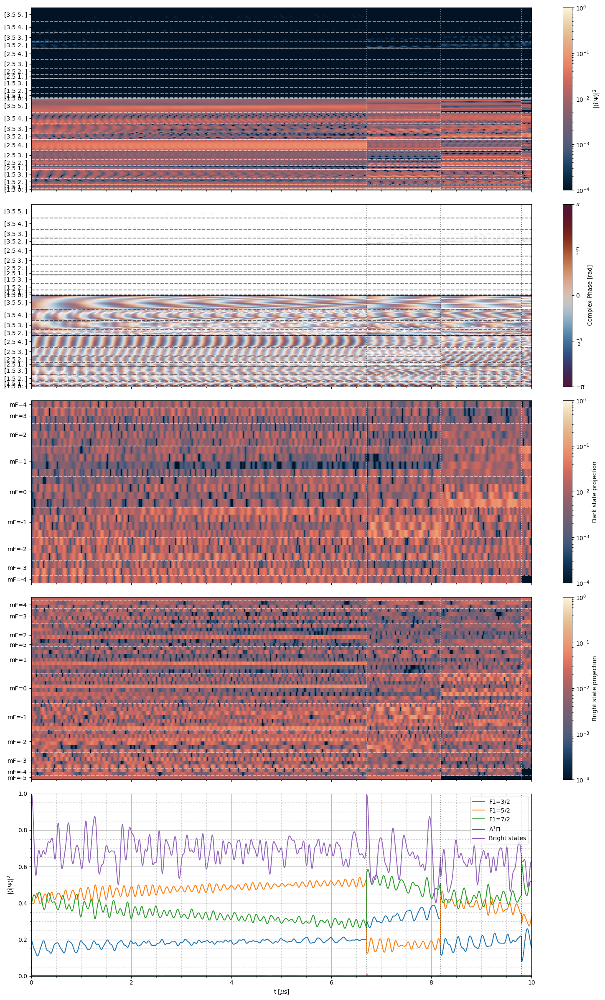

In [102]:
for sol in tqdm.tqdm(sols):
    fig, (ax, axp, axd, axb, ax2) = plt.subplots(5,1,figsize=[16,24],sharex=True)
    coeffs = lambda xs : np.array([np.abs(x.Psi)**2 for x in xs])
    phases = lambda xs : np.array([np.angle(x.Psi) for x in xs])
    cfs = np.sum(coeffs(np.array([sol])),axis=0)
    phs = phases([sol])[0]
    dstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_nspace[0].T)))**2)[nspace_ord]
    shp = dstate_pop.shape
    # dstate_pop = np.append(dstate_pop,1-np.sum(dstate_pop,axis=0)).reshape((shp[0]+1,shp[1]))

    bstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_cspace[0].T)))**2)[cspace_ord]


    ev_times = [ev[-1]*t_unit*1e6 for ev in sol.decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),cfs,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

    c = axp.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),phs,cmap = scicmap.vikO, rasterized=True, norm = mcolors.Normalize(-np.pi,np.pi), alpha=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True)(cfs))#, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axp.get_xlim()
    ylim = axp.get_ylim()
    axp.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axp.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    axp.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    caxp = plt.colorbar(c,ax=axp, ticks = plt.MultipleLocator(np.pi / 2), format = plt.FuncFormatter(multiple_formatter()))
    caxp.set_label("Complex Phase [rad]")

    cd = axd.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(nspace_np.shape[0]))),dstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axd.get_xlim()
    ylim = axd.get_ylim()
    axd.hlines(nspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axd.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axd.set_yticks(nspace_ticks-0.5)
    axd.set_yticklabels(nspace_tickslabels)
    caxd = plt.colorbar(cd,ax=axd)
    caxd.set_label("Dark state projection")

    cb = axb.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(cspace_np.shape[0]))),bstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axb.get_xlim()
    ylim = axb.get_ylim()
    axb.hlines(cspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axb.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axb.set_yticks(cspace_ticks-0.5)
    axb.set_yticklabels(cspace_tickslabels)
    caxb = plt.colorbar(cb,ax=axb)
    caxb.set_label("Bright state projection")

    ax2.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax2.plot(ts*t_unit*1e6,np.sum(bstate_pop,axis=0),label="Bright states")
    ax2.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax2.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax2.minorticks_on()
    ax2.legend()
    ax2.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax2.get_xlim()
    ylim = ax2.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax2.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    ax2.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    ax2.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")
    # cax2 = plt.colorbar(cd,ax=ax2)
    # cax2.set_label("Placeholder")

    fig.tight_layout()
    
    pos = ax.get_position()
    pos2 = ax2.get_position()
    ax2.set_position([pos.x0,pos2.y0,pos.width,pos2.height])

In [104]:
rtime = 10e-6
ts =np.linspace(0,rtime/t_unit,5000)
runN = 1

# mcwf.set_initial_psi(initpsi2)
sols = [mcwf.evolve_state([ts[0],ts[-1]],
                t_eval=ts,
                save_decay=True,
                progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
                # rng = fake_rand,
                decay_ops='mF',
                rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23") for i in tqdm.tqdm(range(runN))]

# sols = []
# for i in tqdm.tqdm(range(qr_nspace[0].shape[1])):
#     mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,i],[0]*72]))
#     sols.append(mcwf.evolve_state([ts[0],ts[-1]],
#                 t_eval=ts,
#                 save_decay=True,
#                 progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
#                 # rng = fake_rand,
#                 rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23"))

100%|██████████| 1/1 [00:16<00:00, 16.18s/it]

Completed in 16.12 s.                                               


C:\Users\LP618\AppData\Local\Temp\ipykernel_31720\2415374665.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  num = np.int(np.rint(den*x/number))
100%|██████████| 1/1 [00:07<00:00,  7.23s/it]


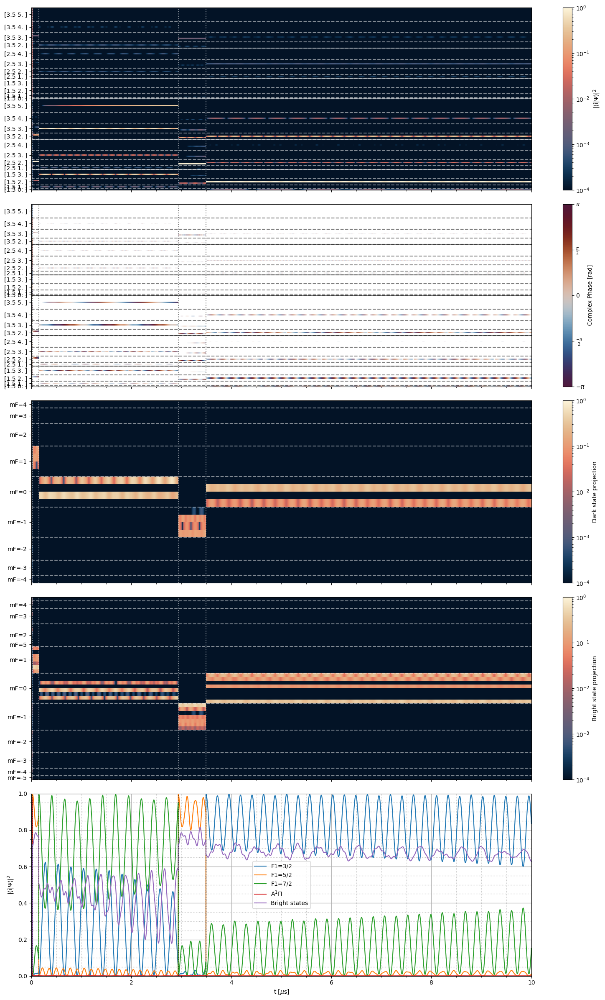

In [105]:
for sol in tqdm.tqdm(sols):
    fig, (ax, axp, axd, axb, ax2) = plt.subplots(5,1,figsize=[16,24],sharex=True)
    coeffs = lambda xs : np.array([np.abs(x.Psi)**2 for x in xs])
    phases = lambda xs : np.array([np.angle(x.Psi) for x in xs])
    cfs = np.sum(coeffs(np.array([sol])),axis=0)
    phs = phases([sol])[0]
    dstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_nspace[0].T)))**2)[nspace_ord]
    shp = dstate_pop.shape
    # dstate_pop = np.append(dstate_pop,1-np.sum(dstate_pop,axis=0)).reshape((shp[0]+1,shp[1]))

    bstate_pop = (np.abs(np.einsum("ij,ki->kj",sol.Psi[:72],np.conjugate(qr_cspace[0].T)))**2)[cspace_ord]


    ev_times = [ev[-1]*t_unit*1e6 for ev in sol.decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),cfs,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

    c = axp.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),phs,cmap = scicmap.vikO, rasterized=True, norm = mcolors.Normalize(-np.pi,np.pi), alpha=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True)(cfs))#, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axp.get_xlim()
    ylim = axp.get_ylim()
    axp.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='k', linestyles='--',alpha=0.5)
    axp.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='k', linestyles='-',alpha=0.5)
    axp.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axp.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    axp.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    caxp = plt.colorbar(c,ax=axp, ticks = plt.MultipleLocator(np.pi / 2), format = plt.FuncFormatter(multiple_formatter()))
    caxp.set_label("Complex Phase [rad]")

    cd = axd.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(nspace_np.shape[0]))),dstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axd.get_xlim()
    ylim = axd.get_ylim()
    axd.hlines(nspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axd.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axd.set_yticks(nspace_ticks-0.5)
    axd.set_yticklabels(nspace_tickslabels)
    caxd = plt.colorbar(cd,ax=axd)
    caxd.set_label("Dark state projection")

    cb = axb.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(cspace_np.shape[0]))),bstate_pop,cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = axb.get_xlim()
    ylim = axb.get_ylim()
    axb.hlines(cspace_index[1:-1]-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    # ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    axb.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    # ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    axb.set_yticks(cspace_ticks-0.5)
    axb.set_yticklabels(cspace_tickslabels)
    caxb = plt.colorbar(cb,ax=axb)
    caxb.set_label("Bright state projection")

    ax2.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    ax2.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax2.plot(ts*t_unit*1e6,np.sum(bstate_pop,axis=0),label="Bright states")
    ax2.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax2.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax2.minorticks_on()
    ax2.legend()
    ax2.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax2.get_xlim()
    ylim = ax2.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax2.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    ax2.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    ax2.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")
    # cax2 = plt.colorbar(cd,ax=ax2)
    # cax2.set_label("Placeholder")

    fig.tight_layout()
    
    pos = ax.get_position()
    pos2 = ax2.get_position()
    ax2.set_position([pos.x0,pos2.y0,pos.width,pos2.height])

In [97]:
(len(sols[0].decay_events)-1)/1e-3/1e3

281.0

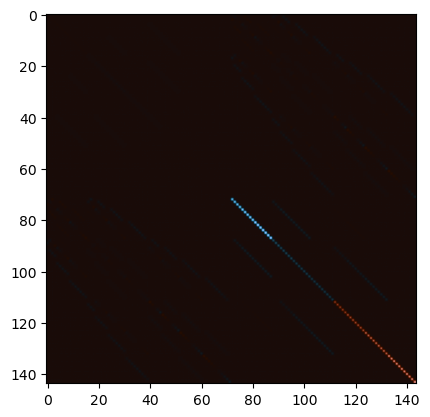

In [1115]:
plt.imshow(np.real(mcwf.H), cmap=scicmap.berlin,norm=mcolors.CenteredNorm(0))

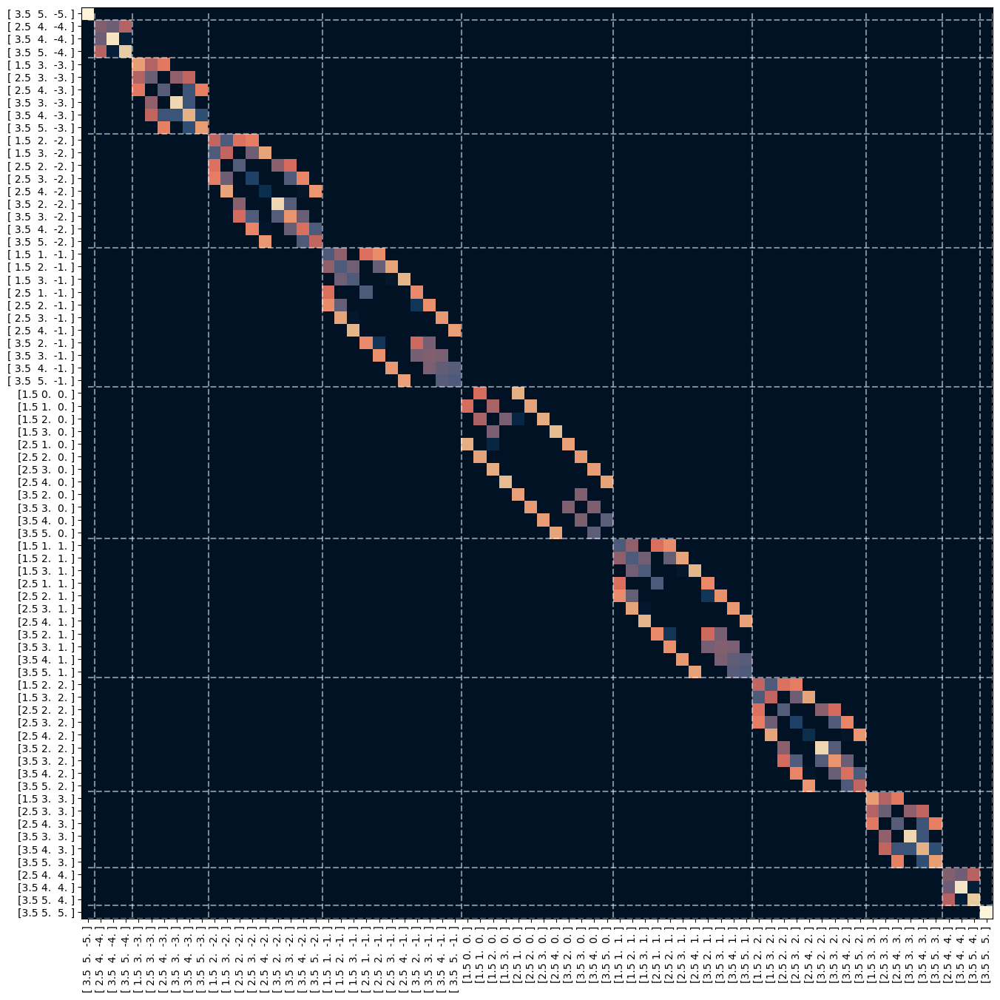

In [ ]:
fig, ax = plt.subplots(1,1,figsize=[16,16])
ax.imshow(np.abs(np.squeeze(np.vectorize(float)(d0))[mfgroup][:,mfgroup]), cmap=scicmap.lipari, norm=mcolors.LogNorm(1e-2,clip=True))
ax.hlines(indx-0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
ax.vlines(indx-0.5, 0,71.5, colors='w', linestyles='--',alpha=0.5)
ax.set_yticks(list(range(72)))
ax.set_yticklabels([str(lab) for lab in labX[mfgroup]])
ax.set_xticks(list(range(72)), rotation='vertical')
ax.set_xticklabels([str(lab) for lab in labX[mfgroup]],  rotation='vertical');

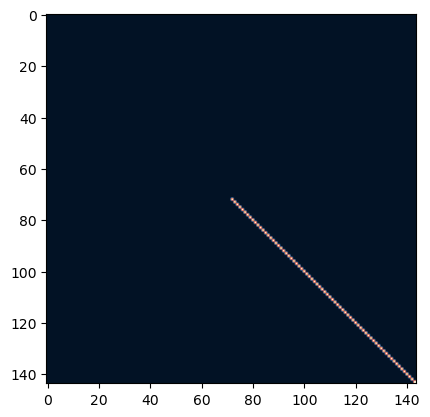

In [1116]:
plt.imshow(np.abs(mcwf.decay_ev), cmap=scicmap.lipari)

In [1117]:
labX[np.argmax(np.abs(sols[0].Psi[:,-1])**2)]

array([1.5, 3. , 1. ])

(0.0, 15000000.0)

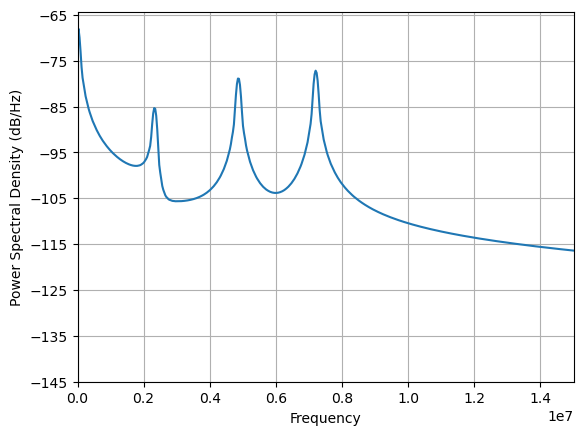

In [103]:
plt.psd(dstate_pop[-1],Fs=1/((ts[1]-ts[0])*t_unit),NFFT=2**14)
plt.xlim(0,15e6)
# plt.ylim(-80,-70)

In [54]:
labA[labA[:,-1]==0]

array([[1.5, 0. , 0. ],
       [1.5, 1. , 0. ],
       [1.5, 2. , 0. ],
       [1.5, 3. , 0. ],
       [2.5, 1. , 0. ],
       [2.5, 2. , 0. ],
       [2.5, 3. , 0. ],
       [2.5, 4. , 0. ],
       [3.5, 2. , 0. ],
       [3.5, 3. , 0. ],
       [3.5, 4. , 0. ],
       [3.5, 5. , 0. ]])

In [108]:
lasers = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':-70e6*2*np.pi/Hz_unit, 's':1}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
mcwf = pylcp.MCWF(lasers, no_mag_field, ham)
mcwf.set_initial_psi(np.concatenate([[0]*72,[1/72]*72]))
# mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,7],[0]*72]))

Text(0, 0.5, 'E (MHz)')

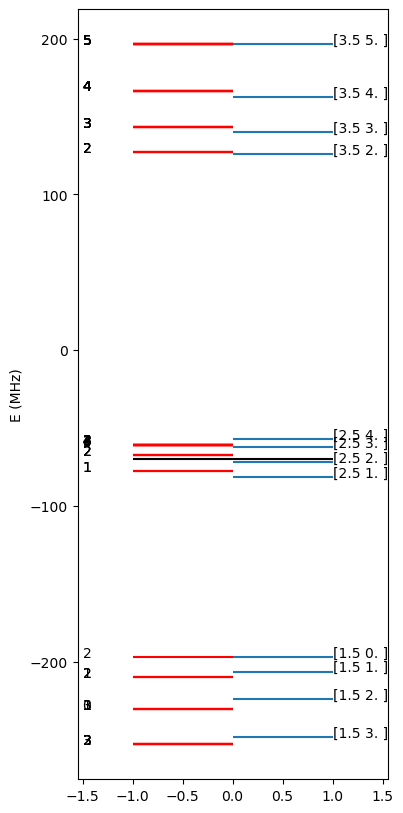

In [107]:
plt.figure(figsize=(4,10))
EA, U = np.linalg.eigh(H0A+1e-9*np.diag(np.array(list(range(72)))))
plt.hlines(EA,-1,0,colors="r")
plt.hlines(-70,-1,1,colors="k")
plt.hlines(np.diag(H0A)[labA[:,-1]==0],0,1)
[plt.text(1,E,f"{lab[:2]}") for lab, E in zip(labA[labA[:,-1]==0],np.diag(H0A)[labA[:,-1]==0])]
[plt.text(-1.5,E,f"{round(lab)}") for E, lab in zip(EA,np.abs(U)**2@labA[:,1])]
plt.xlim(-1.55,1.55)
plt.ylabel("E (MHz)")

In [ ]:
import pathos.multiprocessing as mp
rtime = 50e-6
ts =np.linspace(0,rtime/t_unit,5000)
runN = 1

# # mcwf.set_initial_psi(initpsi2)
# sols = [mcwf.evolve_state([ts[0],ts[-1]],
#                 t_eval=ts,
#                 save_decay=True,
#                 progress_bar=True,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
#                 # rng = fake_rand,
#                 decay_ops='mF',
#                 rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23") for i in tqdm.tqdm(range(runN))]

sols = []
dets = np.linspace(-300,300,64)
# dets = [-80]
# for i in tqdm.tqdm(range(qr_nspace[0].shape[1])):
#     lasers = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
#             {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':-70e6*2*np.pi/Hz_unit, 's':1}
#             ], beam_type=pylcp.infinitePlaneWaveBeam)}
#     mcwf = pylcp.MCWF(lasers, no_mag_field, ham)
#     mcwf.set_initial_psi(np.concatenate([[0]*72,[1/72]*72]))
#     # mcwf.set_initial_psi(np.concatenate([qr_nspace[0][:,nspace_ord][:,7],[0]*72]))
#     sols.append()

def run(args):
    det, velocity_unit, ts, t_unit, np, cm_unit, mcwf, ksim, Hz_unit, pylcp = args
    lasers = {'X(v=0)->A(v=0)' : pylcp.laserBeams([
            {'kvec':np.array([-1, 0, 0.])*ksim, 'pol':np.array([0,0,1]), 'pol_coord': 'cartesian', 'delta':det*1e6*2*np.pi/Hz_unit, 's':1}
            ], beam_type=pylcp.infinitePlaneWaveBeam)}
    mcwf.laserBeams = lasers
    mcwf.set_initial_psi(np.concatenate([[0]*72,[1/72]*72]))
    return mcwf.evolve_state([ts[0],ts[-1]],
                t_eval=ts,
                save_decay=True,
                progress_bar=False,freeze_axis=np.array([False,True,True]),max_step = 1e-9/t_unit,
                # rng = fake_rand,
                rtol=1e-2, atol=np.concatenate(([1e-5]*144,[1/velocity_unit,1/velocity_unit,1/velocity_unit,1e-1/cm_unit,1e-1/cm_unit,1e-1/cm_unit])),method="RK23")
    
with mp.Pool(16) as pool:
    sols += pool.map(run, zip(dets, [velocity_unit]*len(dets),[ts]*len(dets),[t_unit]*len(dets),[np]*len(dets),[cm_unit]*len(dets), [mcwf]*len(dets), [ksim]*len(dets), [Hz_unit]*len(dets), [pylcp]*len(dets)),16)

In [ ]:
plt.plot(dets, [(len(sol.decay_events)-1)/rtime/1e3 for sol in sols], 'x')

c:\Users\LP618\Anaconda3\lib\site-packages\scipy\integrate\_ivp\common.py:39: UserWarning: The following arguments have no effect for a chosen solver: `freeze_axis`.
  warn("The following arguments have no effect for a chosen solver: {}."


KeyboardInterrupt: 

<ErrorbarContainer object of 3 artists>

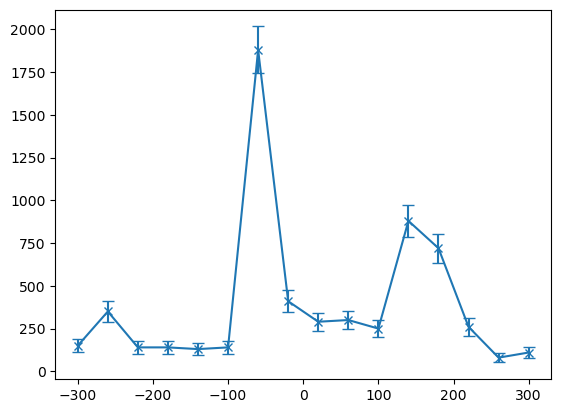

In [ ]:
plt.errorbar(dets, [(len(sol.decay_events)-1)/rtime/1e3 for sol in sols], yerr= [np.sqrt(len(sol.decay_events)-1)/rtime/1e3 for sol in sols], fmt= 'x-', capsize=4)

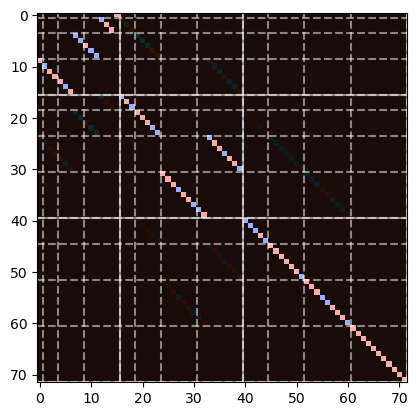

In [86]:
EA, U = np.linalg.eigh(H0A+1e-9*np.diag(np.array(list(range(72)))))
plt.imshow(U, cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
plt.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
plt.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
plt.vlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *ylim, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *ylim, colors='w', linestyles='-',alpha=0.5)

In [89]:
np.abs(U)**2@labA

array([[ 1.50000000e+00,  3.00000000e+00,  3.00000000e+00],
       [ 1.52744712e+00,  2.94510575e+00, -2.74471226e-02],
       [ 1.52744712e+00,  2.94510575e+00,  9.72552878e-01],
       [ 1.52744712e+00,  2.94510575e+00,  1.97255288e+00],
       [ 1.53704657e+00,  2.00000000e+00,  8.89619749e-01],
       [ 1.53704657e+00,  2.00000001e+00,  1.88961968e+00],
       [ 1.53704657e+00,  2.96320657e+00, -2.88961968e+00],
       [ 1.53704657e+00,  2.96320658e+00, -1.88961975e+00],
       [ 1.53704657e+00,  2.96320658e+00, -8.89619748e-01],
       [ 1.52416165e+00,  9.44295450e-02, -4.78798873e-02],
       [ 1.52416165e+00,  1.07071131e+00, -1.00044341e+00],
       [ 1.52416165e+00,  1.07071131e+00, -4.43409988e-04],
       [ 1.52416165e+00,  1.07071131e+00,  9.99556585e-01],
       [ 1.52416165e+00,  2.04699307e+00, -1.90557045e+00],
       [ 1.52416165e+00,  2.04699307e+00, -9.05570452e-01],
       [ 1.52416165e+00,  2.04699307e+00,  9.44295442e-02],
       [ 2.47255288e+00,  1.05489425e+00

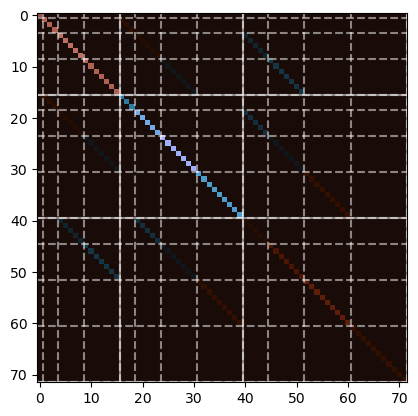

In [78]:
plt.imshow(H0X, cmap=scicmap.berlin, norm=mcolors.CenteredNorm(0))
ylim = plt.ylim()
xlim = plt.xlim()
plt.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
plt.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
plt.vlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *ylim, colors='w', linestyles='--',alpha=0.5)
plt.vlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *ylim, colors='w', linestyles='-',alpha=0.5)

Text(0, 0.5, 'E (MHz)')

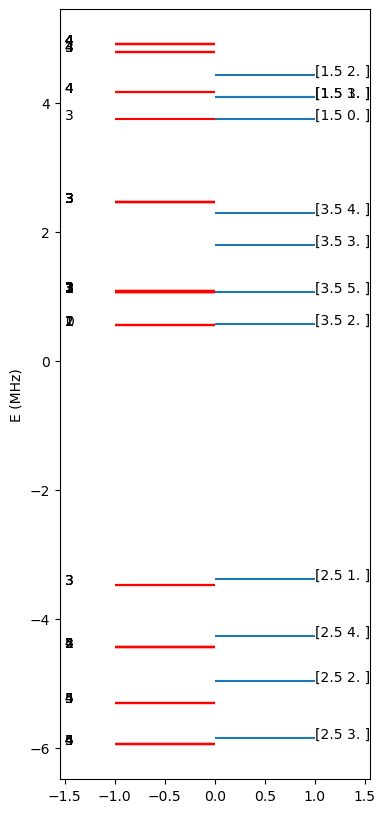

In [54]:
plt.figure(figsize=(4,10))
EX, U = np.linalg.eigh(H0X+1e-9*np.diag(np.array(list(range(72)))))
plt.hlines(EX,-1,0,colors="r")
plt.hlines(np.diag(H0X)[labX[:,-1]==0],0,1)
[plt.text(1,E,f"{lab[:2]}") for lab, E in zip(labX[labX[:,-1]==0],np.diag(H0X)[labX[:,-1]==0])]
[plt.text(-1.5,E,f"{round(lab)}") for E, lab in zip(EX,np.abs(U)**2@labX[:,1])]
plt.xlim(-1.55,1.55)
plt.ylabel("E (MHz)")

In [1120]:
len(ev_times)/(ts[-1]*t_unit)/1e6

4.2

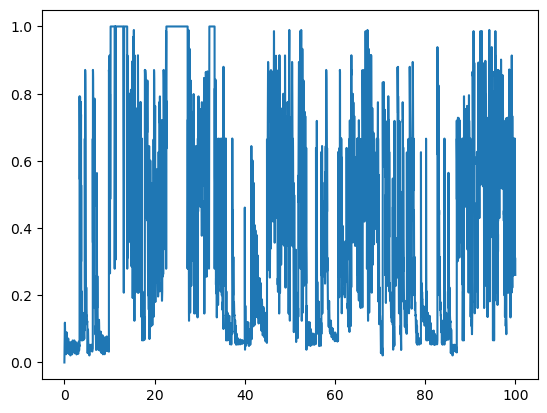

In [1121]:
plt.plot(ts*t_unit*1e6,dstate_pop[-1],label="Bright states")

In [519]:
nspace_np_norm = nspace_np/np.sqrt(np.einsum("ij,ji->i",np.conjugate(nspace_np),nspace_np.T))[:,np.newaxis]

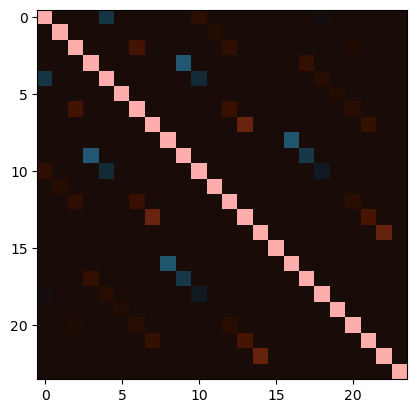

In [522]:
plt.imshow(np.einsum("ij,jk->ik",nspace_np_norm,np.conjugate(nspace_np_norm.T)),cmap=scicmap.berlin,norm=mcolors.CenteredNorm(0))

In [ ]:
initpsi2 = sols[0].Psi[:,-1]

In [291]:
initpsi = sols[0].Psi[:,-1]

In [255]:
len(sols[0].decay_events)

60

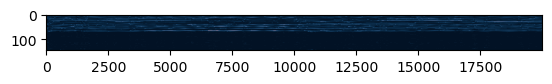

In [ ]:
plt.imshow(np.sum(coeffs(np.array(sols)),axis=0),cmap = scicmap.lipari, aspect = 10)

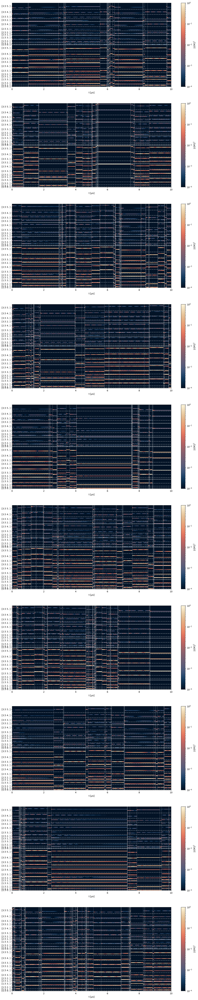

In [246]:
fig, axs = plt.subplots(10,1,figsize=[16,80])


for i, ax in enumerate(axs):
    ev_times = [ev[-1]*t_unit*1e6 for ev in sols[i].decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),np.sum(coeffs(np.array([sols[i]])),axis=0),cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    ax.set_xlabel("t [$\\mu$s]")
    # ax.set_xlim(3,4)
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

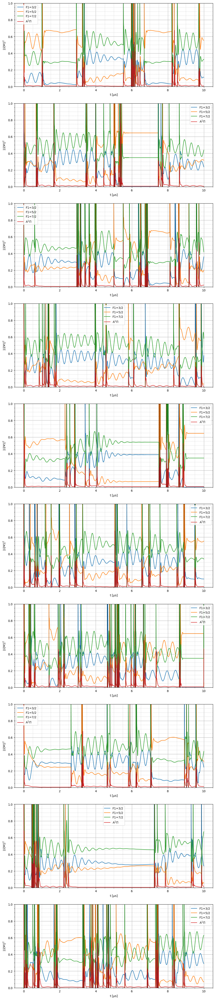

In [241]:
fig, axs = plt.subplots(10,1,figsize=[12,60])
#[16., 40., 72.]

for i, ax in enumerate(axs):
    cfs = np.sum(coeffs(np.array([sols[i]])),axis=0)
    ev_times = [ev[-1]*t_unit*1e6 for ev in sols[i].decay_events]
    ax.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax.minorticks_on()
    ax.legend()
    ax.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    ax.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    ax.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")

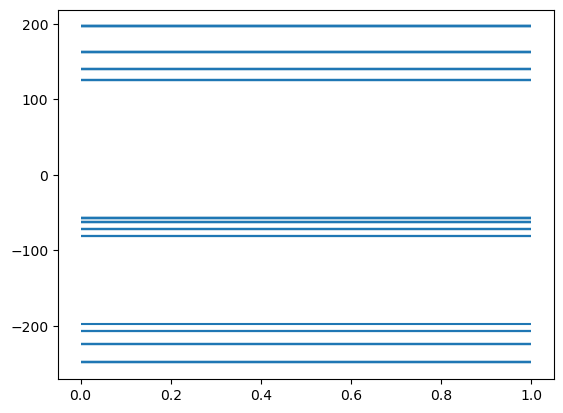

In [227]:
plt.hlines(np.diag(H0A),0,1)

In [228]:
np.cumsum(4*(2*np.unique(labX[:,0],axis=0)+1))

array([16., 40., 72.])

IndexError: list index out of range

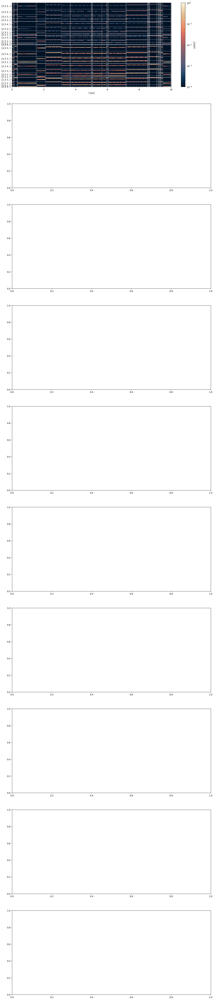

In [412]:
fig, axs = plt.subplots(10,1,figsize=[16,80])


for i, ax in enumerate(axs):
    ev_times = [ev[-1]*t_unit*1e6 for ev in sols[i].decay_events]
    c = ax.pcolormesh(*np.meshgrid(ts*t_unit*1e6,list(range(144))),np.sum(coeffs(np.array([sols[i]])),axis=0),cmap = scicmap.lipari, rasterized=True, norm=mcolors.LogNorm(vmax=1, vmin=1e-4,clip=True))
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.hlines(72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    ax.hlines(72+np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='w', linestyles='dotted',alpha=0.5)
    ax.set_xlabel("t [$\\mu$s]")
    ax.set_yticks(np.concatenate([np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1,72+np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1]))
    ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)]*2)
    cax = plt.colorbar(c,ax=ax)
    cax.set_label("|$\\langle$i|$\\Psi\\rangle$|$^2$")

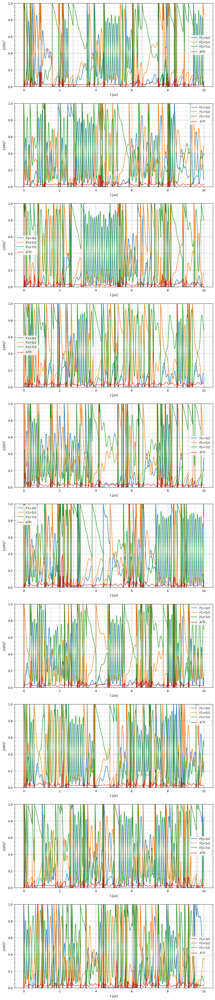

In [234]:
fig, axs = plt.subplots(10,1,figsize=[12,60])
#[16., 40., 72.]

for i, ax in enumerate(axs):
    cfs = np.sum(coeffs(np.array([sols[i]])),axis=0)
    ev_times = [ev[-1]*t_unit*1e6 for ev in sols[i].decay_events]
    ax.plot(ts*t_unit*1e6,np.sum(cfs[:16],axis=0),label="F1=3/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[16:40],axis=0),label="F1=5/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[40:72],axis=0),label="F1=7/2")
    ax.plot(ts*t_unit*1e6,np.sum(cfs[72:],axis=0),label="A$^1\\Pi$")
    ax.grid(True, which='major', linestyle='-', linewidth=1, alpha=0.9)
    ax.grid(True, which='minor', linestyle=':', linewidth=1, alpha=0.8)
    ax.minorticks_on()
    ax.legend()
    ax.set_ylim(0,1)
    # ax.set_xlim(7,8)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    # ax.hlines(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1)-0.5, *xlim, colors='w', linestyles='--',alpha=0.5)
    # ax.hlines(np.cumsum(4*(2*np.unique(labX[:,0],axis=0) + 1))-0.5, *xlim, colors='w', linestyles='-',alpha=0.5)
    ax.vlines(ev_times,*ylim, colors='k', linestyles='dotted',alpha=0.5)
    ax.set_xlabel("t [$\\mu$s]")
    # ax.set_yticks(np.cumsum(2*np.unique(labX[:,(0,1)],axis=0)[:,1] + 1) - np.unique(labX[:,(0,1)],axis=0)[:,1]-1)
    # ax.set_yticklabels([str(a) for a in np.unique(labX[:,(0,1)],axis=0)])
    # cax = plt.colorbar(c,ax=ax)
    ax.set_ylabel("|$\\langle$i|$\\Psi\\rangle$|$^2$")

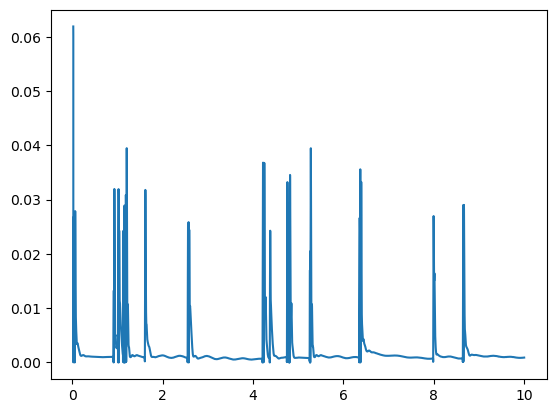

In [251]:
plt.plot((ts*t_unit*1e6)[50:],np.sum(coeffs(np.array(sols))[:,72:],axis=(0,1))[50:]/10)
# plt.yscale('log')

In [233]:
sols[2].Psi[np.argmin(np.abs(ts*1e6*t_unit) - 4.5)]

array([ 0.00000000e+00+0.00000000e+00j, -1.68858269e-05+5.26354923e-04j,
       -7.18547229e-05+1.10015658e-03j, ...,
       -3.57533640e-71+7.86574400e-71j, -3.46855361e-71+7.88230366e-71j,
       -3.36545462e-71+7.89693763e-71j])